<a href="https://colab.research.google.com/github/arshika77/SAiDL_Summer_of_Code/blob/master/SAiDL_4_2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Since the notebook is rather long, here is a quick TLDR.

Using the LeNet architecture, an approximate test accuarcy of 60% can be obtained on the Cifar-10 dataset

After generating DCGAN images and augmenting the Cifar-10 dataset with them, accuracy improved to the magnitude of ~1%. It's important to note here that around 2000 images were generated from DCGAN which could explain the low gain in accuracy. With multiple GPUs and better hardware, the DCGAN training could be done for many more epochs, to generate a comparable number of GAN images for data augmentation. It can be expected that this augmentation will lead to huge gains in accuracy,considering that an accuracy gain could be obtained with very little DCGAN augmentation as well.

Other Data augmentation techniques used were Horizontal image flipping, Random rotation of the image, Color Jitter. These were then combined together and used for augmentation. Finally, the DCGAN images were also added to this transformation. An increase in accuracy was seen in most cases over the simple training with no data augmentation.



---

No Augmentation ~ 60%


---

DCGAN Augmentation ~ 61%



---

Random Horizontal Flip ~ 63%


---

Random rotation ~ 50%



---

Color Jitter ~ 65%

---

Multiple Augmnetation - 51%


---

Multiple Augmentation with DCGAN - 51%


---









The lower accuracy in random rotation is probably due to classes like plane and ship where a rotated image destroys meaning to some extent. For all other classes, a rotated image merely acts as a substitute for the image in different orientations and helps the model learn how to identify the image when the object is not centrally oriented. While, it is difficult to pin-point the exact reason of decrease in accuarcy, we can assume that planes, ship and cars at 90 degree angles results in inconsistent imagery

Color Jitter and Random Horizontal Flip work well as they create variance in the images without creating inconsistencies. A horizontally flipped car is still a car, and so is one which is a brighter shade or has more contrast. Thus, these lead to an increase in accuracies

Lower accuarcies in multiple augmentation can also be attributed to the negative effect of using Random Rotation

**MNIST**

Note: Since MNIST is able to gain 95%+ accuracy with even simple FNNs or CNNs models, a very simple 2-layer FNN was used to generate lower accuracy to accurately analyse the impact of data augmentation on the MNIST dataset

DCGAN augmentation led to an increase in accuracy as expected. Again, we can run the training for more epochs to generate number of images comparable to the dataset to get greater accuarcy gains.

However, Image flipping, rotation and color jitter all led to a drastic decrease in accuracy. This is because the images in question contain numbers where orientation is of prime importance. A flipped 2 is not the same as a 2, and training the model on a flipped 2 might make it learn features which are not relevant when classifying an image as 2. This leads to a decrease in accuracy. Rotation is not as extreme as a complete flip, hence the accuracy reduction is lower. Color jitter also doesn't introduce many inconsisitencies, thus the accuarcy is comparable to no augmentation, though slightly on the lower side.



---

No Augmentation ~ 74%


---

DCGAN Augmentation ~ 75%



---

Random Horizontal Flip ~ 30%


---

Random rotation ~ 50%



---

Color Jitter ~ 67%

---

Multiple Augmnetation - 40%


---

Multiple Augmentation with DCGAN - 31%


---









**Conclusion** : Thus, as we can see from the data augmentation exercise on the CIFAR 10 and the MNIST dataset, the effectiveness of data augmentation largely depends on the dataset. Dataset should be such that on augmentation, it leads to variance in the image without destroying the information content in the image. Therefore, which augmentation techniques will work depend on the kind of dataset we are dealing with. In Cifar-10, almost all augmentation techniques led to increased accuarcy, however in MNIST only DCGAN augmentation led to favourable results, owing largely to the dataset being dealt with.

---





---

Making the necessary imports:


In [66]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.optim as optim
import os
import cv2
from google.colab.patches import cv2_imshow

manualSeed = 999

##Loading the dataset

In [2]:
trainset = torchvision.datasets.CIFAR10(root='./data', train=True, 
                                        download=True, 
                                        transform=transforms.ToTensor())

Extracting ./data/cifar-10-python.tar.gz to ./data


In [3]:
classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

In [4]:
trainloader = torch.utils.data.DataLoader(trainset, batch_size=4, shuffle=True)

In [5]:
dataiter = iter(trainloader)
images, labels = dataiter.next()

print(images.shape)

print(images[1].shape)
print(labels[1].item())

torch.Size([4, 3, 32, 32])
torch.Size([3, 32, 32])
0


##Visualize the data

In [ ]:
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

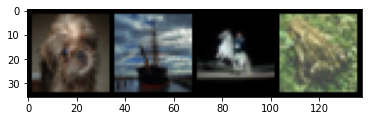

dog ship horse frog


In [ ]:
imshow(torchvision.utils.make_grid(images))
print(' '.join(classes[labels[j]] for j in range(4)))

##LeNet Architecture

In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [7]:
class LeNet(nn.Module):
    def __init__(self): 
        super(LeNet, self).__init__()
        self.cnn_model = nn.Sequential(
            nn.Conv2d(3, 6, 5),         # (N, 3, 32, 32) -> (N,  6, 28, 28)
            nn.Tanh(),
            nn.AvgPool2d(2, stride=2),  # (N, 6, 28, 28) -> (N,  6, 14, 14)
            nn.Conv2d(6, 16, 5),        # (N, 6, 14, 14) -> (N, 16, 10, 10)  
            nn.Tanh(),
            nn.AvgPool2d(2, stride=2)   # (N,16, 10, 10) -> (N, 16, 5, 5)
        )
        self.fc_model = nn.Sequential(
            nn.Linear(400,120),         # (N, 400) -> (N, 120)
            nn.Tanh(),
            nn.Linear(120,84),          # (N, 120) -> (N, 84)
            nn.Tanh(),
            nn.Linear(84,10)            # (N, 84)  -> (N, 10)
        )
        
    def forward(self, x):
        #print(x.shape)
        x = self.cnn_model(x)
        #print(x.shape)
        x = x.view(x.size(0), -1)
        #print(x.shape)
        x = self.fc_model(x)
        #print(x.shape)
        return x

##Training LeNet

In [8]:
batch_size = 128
trainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transforms.ToTensor())
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True)
testset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transforms.ToTensor())
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


In [9]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = net(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [10]:
net = LeNet().to(device)

In [11]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(net.parameters(),weight_decay=4e-3)

Epoch: 0/60, Test acc: 58.13, Train acc: 60.84
Epoch: 10/60, Test acc: 59.84, Train acc: 63.09
Epoch: 20/60, Test acc: 59.96, Train acc: 62.77
Epoch: 30/60, Test acc: 59.27, Train acc: 62.91
Epoch: 40/60, Test acc: 59.54, Train acc: 63.20
Epoch: 50/60, Test acc: 60.12, Train acc: 63.06
Epoch: 59/60, Test acc: 60.18, Train acc: 63.47


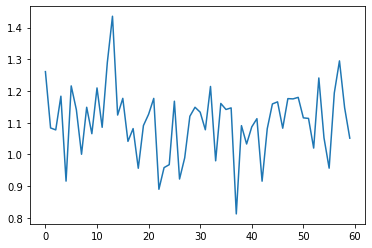

In [ ]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

for epoch in range(max_epochs):

    for i, data in enumerate(trainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = net(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(testloader), evaluation(trainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

#Data Augmentation using DCGANs

In [12]:
dataset = torchvision.datasets.CIFAR10(root='./data',
                                        download=True, 
                                        transform=transforms.Compose([
                                            transforms.Resize(64),
                                            transforms.ToTensor(),
                                            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                        ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True)

Files already downloaded and verified


nc = number of channels

ngpu = number of gpus

nz = number of noise channels

ngf = number of features of generated image

ndf = number of features of image fed to discriminator

In [13]:
nc = 3
ngpu = 1
nz = 100
ngf = 64
ndf = 64

In [14]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

##Generator Class

In [15]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
            return output

In [16]:
netG = Generator(ngpu).to(device)
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


##Discriminator Class

In [17]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)

        return output.view(-1, 1).squeeze(1)

In [18]:
netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


###Training DCGAN

In [19]:
criterion = nn.BCELoss()

# setup optimizer
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [20]:
fixed_noise = torch.randn(128, nz, 1, 1, device=device)
real_label = 1
fake_label = 0

In [ ]:
niter = 25
g_loss = []
d_loss = []

for epoch in range(niter):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        # train with real
        netD.zero_grad()
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, device=device, dtype = torch.float)

        output = netD(real_cpu)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # train with fake
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach())
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        output = netD(fake)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f' % (epoch, niter, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        #save the output
        if i % 100 == 0:
            print('saving the output')
            torchvision.utils.save_image(real_cpu,'output/real_samples.png',normalize=True)
            fake = netG(fixed_noise)
            torchvision.utils.save_image(fake.detach(),'output/fake_samples_epoch_%03d.png' % (epoch),normalize=True)
    
    # Check pointing for every epoch
    torch.save(netG.state_dict(), 'weights/netG_epoch_%d.pth' % (epoch))
    torch.save(netD.state_dict(), 'weights/netD_epoch_%d.pth' % (epoch))

Streaming output truncated to the last 5000 lines.
[12/25][134/391] Loss_D: 0.4616 Loss_G: 1.5907 D(x): 0.7533 D(G(z)): 0.1357 / 0.2431
[12/25][135/391] Loss_D: 0.5373 Loss_G: 5.3998 D(x): 0.9827 D(G(z)): 0.3711 / 0.0062
[12/25][136/391] Loss_D: 0.8272 Loss_G: 0.8860 D(x): 0.5012 D(G(z)): 0.0188 / 0.4576
[12/25][137/391] Loss_D: 0.9774 Loss_G: 5.5772 D(x): 0.9974 D(G(z)): 0.5734 / 0.0058
[12/25][138/391] Loss_D: 0.5479 Loss_G: 2.1782 D(x): 0.6293 D(G(z)): 0.0159 / 0.1500
[12/25][139/391] Loss_D: 0.2639 Loss_G: 3.7846 D(x): 0.9782 D(G(z)): 0.2023 / 0.0315
[12/25][140/391] Loss_D: 0.0771 Loss_G: 4.6383 D(x): 0.9495 D(G(z)): 0.0233 / 0.0158
[12/25][141/391] Loss_D: 0.1563 Loss_G: 3.2071 D(x): 0.9150 D(G(z)): 0.0581 / 0.0582
[12/25][142/391] Loss_D: 0.0880 Loss_G: 3.8373 D(x): 0.9784 D(G(z)): 0.0621 / 0.0303
[12/25][143/391] Loss_D: 0.3813 Loss_G: 5.7313 D(x): 0.9817 D(G(z)): 0.2859 / 0.0042
[12/25][144/391] Loss_D: 0.5778 Loss_G: 3.3314 D(x): 0.6192 D(G(z)): 0.0080 / 0.0521
[12/25][145/39

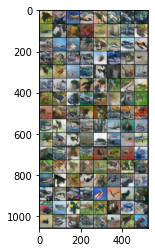

In [ ]:
import matplotlib.image as img 
 
im = img.imread('images/output/fake_samples_epoch_023.png') 
plt.imshow(im) 

##Cropping the image into subimages

In [ ]:
!zip -r output.zip output/

updating: output/ (stored 0%)
updating: output/fake_samples_epoch_021.png (deflated 0%)
updating: output/fake_samples_epoch_013.png (deflated 0%)
updating: output/fake_samples_epoch_006.png (deflated 0%)
updating: output/fake_samples_epoch_002.png (deflated 0%)
updating: output/fake_samples_epoch_001.png (deflated 0%)
updating: output/fake_samples_epoch_010.png (deflated 0%)
updating: output/fake_samples_epoch_003.png (deflated 0%)
updating: output/fake_samples_epoch_020.png (deflated 0%)
updating: output/real_samples.png (deflated 0%)
updating: output/fake_samples_epoch_018.png (deflated 0%)
updating: output/fake_samples_epoch_022.png (deflated 0%)
updating: output/fake_samples_epoch_000.png (deflated 0%)
updating: output/fake_samples_epoch_019.png (deflated 0%)
updating: output/fake_samples_epoch_024.png (deflated 0%)
updating: output/fake_samples_epoch_014.png (deflated 0%)
updating: output/fake_samples_epoch_015.png (deflated 0%)
updating: output/fake_samples_epoch_017.png (deflate

In [26]:
!unzip "output.zip" -d "images"

Archive:  output.zip
   creating: images/output/
  inflating: images/output/fake_samples_epoch_021.png  
  inflating: images/output/fake_samples_epoch_013.png  
  inflating: images/output/fake_samples_epoch_006.png  
  inflating: images/output/fake_samples_epoch_002.png  
  inflating: images/output/fake_samples_epoch_001.png  
  inflating: images/output/fake_samples_epoch_010.png  
  inflating: images/output/fake_samples_epoch_003.png  
  inflating: images/output/fake_samples_epoch_020.png  
  inflating: images/output/real_samples.png  
  inflating: images/output/fake_samples_epoch_018.png  
  inflating: images/output/fake_samples_epoch_022.png  
  inflating: images/output/fake_samples_epoch_000.png  
  inflating: images/output/fake_samples_epoch_019.png  
  inflating: images/output/fake_samples_epoch_024.png  
  inflating: images/output/fake_samples_epoch_014.png  
  inflating: images/output/fake_samples_epoch_015.png  
  inflating: images/output/fake_samples_epoch_017.png  
  inflati

In [22]:
!ls

data  gan-data.zip  images  output.zip	PyTorch_CIFAR10.zip  sample_data


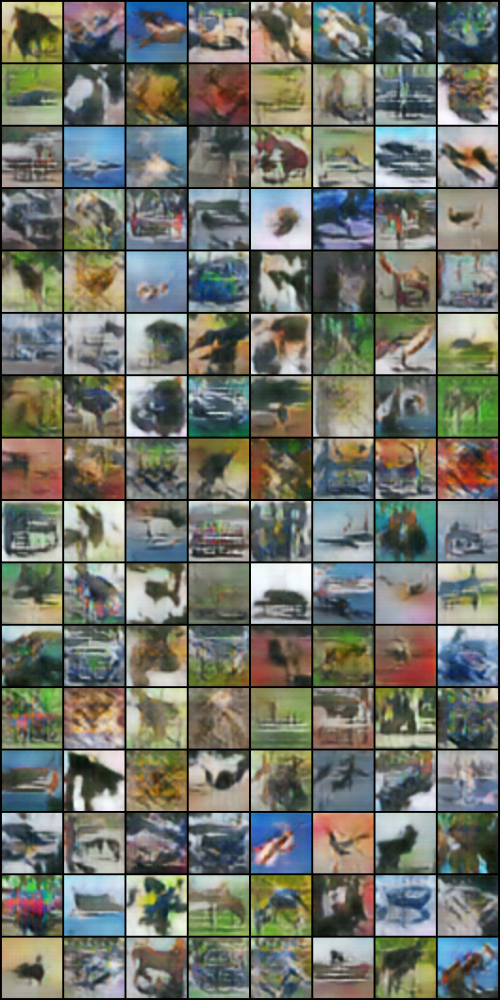

-1

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread('images/output/fake_samples_epoch_023.png')
cv2_imshow(image)
cv2.waitKey(0) 

In [ ]:
height, width = image.shape[:2]
print(image.shape)

(1058, 530, 3)


In [27]:
def subimages(image,height,width,filename):
  crop_height = height * .0625
  crop_width = width * .125

  rows = 16
  cols = 8

  for row in range(rows):
    for col in range(cols):
      tempname = filename
      start_row, start_col = int(row*crop_height), int(col*crop_width)
      end_row, end_col = int((row+1)*crop_height), int((col+1)*crop_width)
      cropped_img = image[start_row:end_row, start_col:end_col]
      tempname = tempname + str(start_row) + str(start_col) + '.png'
      cv2.imwrite(tempname, cropped_img)
      print(start_row, end_row)
      print(start_col, end_col)

      cv2_imshow(cropped_img)
      cv2.waitKey(0)
      cv2.destroyAllWindows()


images/output/fake_samples_epoch_006.png
0 66
0 66


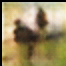

0 66
66 132


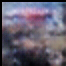

0 66
132 198


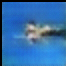

0 66
198 265


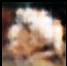

0 66
265 331


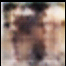

0 66
331 397


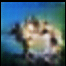

0 66
397 463


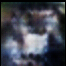

0 66
463 530


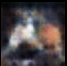

66 132
0 66


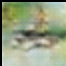

66 132
66 132


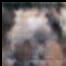

66 132
132 198


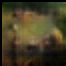

66 132
198 265


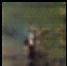

66 132
265 331


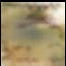

66 132
331 397


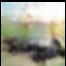

66 132
397 463


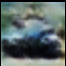

66 132
463 530


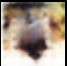

132 198
0 66


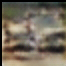

132 198
66 132


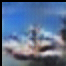

132 198
132 198


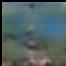

132 198
198 265


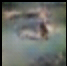

132 198
265 331


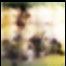

132 198
331 397


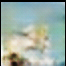

132 198
397 463


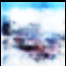

132 198
463 530


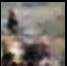

198 264
0 66


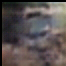

198 264
66 132


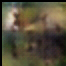

198 264
132 198


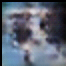

198 264
198 265


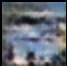

198 264
265 331


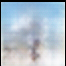

198 264
331 397


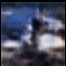

198 264
397 463


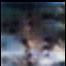

198 264
463 530


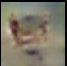

264 330
0 66


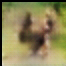

264 330
66 132


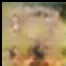

264 330
132 198


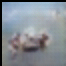

264 330
198 265


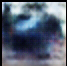

264 330
265 331


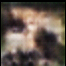

264 330
331 397


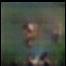

264 330
397 463


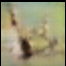

264 330
463 530


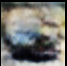

330 396
0 66


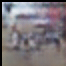

330 396
66 132


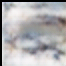

330 396
132 198


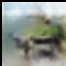

330 396
198 265


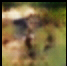

330 396
265 331


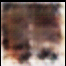

330 396
331 397


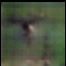

330 396
397 463


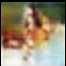

330 396
463 530


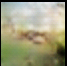

396 462
0 66


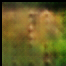

396 462
66 132


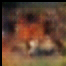

396 462
132 198


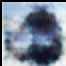

396 462
198 265


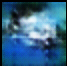

396 462
265 331


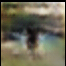

396 462
331 397


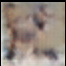

396 462
397 463


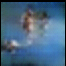

396 462
463 530


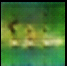

462 529
0 66


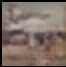

462 529
66 132


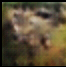

462 529
132 198


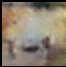

462 529
198 265


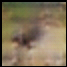

462 529
265 331


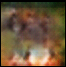

462 529
331 397


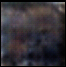

462 529
397 463


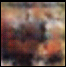

462 529
463 530


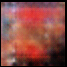

529 595
0 66


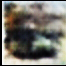

529 595
66 132


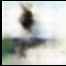

529 595
132 198


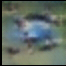

529 595
198 265


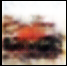

529 595
265 331


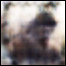

529 595
331 397


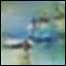

529 595
397 463


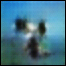

529 595
463 530


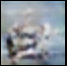

595 661
0 66


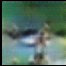

595 661
66 132


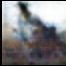

595 661
132 198


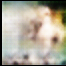

595 661
198 265


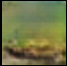

595 661
265 331


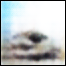

595 661
331 397


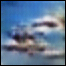

595 661
397 463


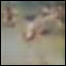

595 661
463 530


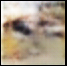

661 727
0 66


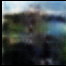

661 727
66 132


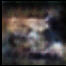

661 727
132 198


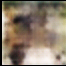

661 727
198 265


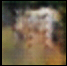

661 727
265 331


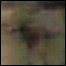

661 727
331 397


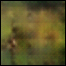

661 727
397 463


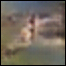

661 727
463 530


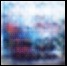

727 793
0 66


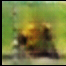

727 793
66 132


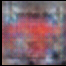

727 793
132 198


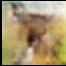

727 793
198 265


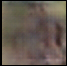

727 793
265 331


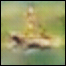

727 793
331 397


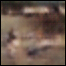

727 793
397 463


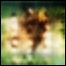

727 793
463 530


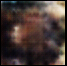

793 859
0 66


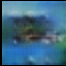

793 859
66 132


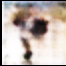

793 859
132 198


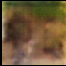

793 859
198 265


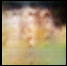

793 859
265 331


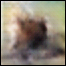

793 859
331 397


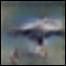

793 859
397 463


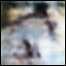

793 859
463 530


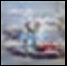

859 925
0 66


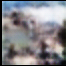

859 925
66 132


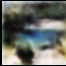

859 925
132 198


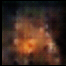

859 925
198 265


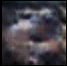

859 925
265 331


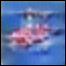

859 925
331 397


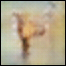

859 925
397 463


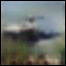

859 925
463 530


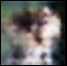

925 991
0 66


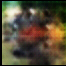

925 991
66 132


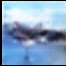

925 991
132 198


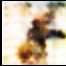

925 991
198 265


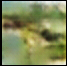

925 991
265 331


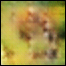

925 991
331 397


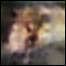

925 991
397 463


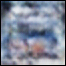

925 991
463 530


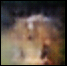

991 1058
0 66


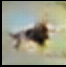

991 1058
66 132


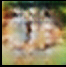

991 1058
132 198


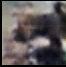

991 1058
198 265


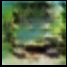

991 1058
265 331


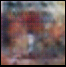

991 1058
331 397


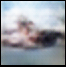

991 1058
397 463


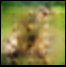

991 1058
463 530


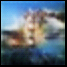

images/output/fake_samples_epoch_007.png
0 66
0 66


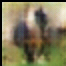

0 66
66 132


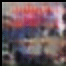

0 66
132 198


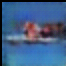

0 66
198 265


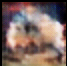

0 66
265 331


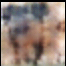

0 66
331 397


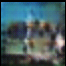

0 66
397 463


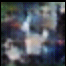

0 66
463 530


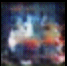

66 132
0 66


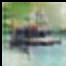

66 132
66 132


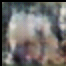

66 132
132 198


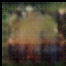

66 132
198 265


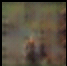

66 132
265 331


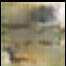

66 132
331 397


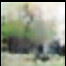

66 132
397 463


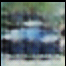

66 132
463 530


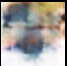

132 198
0 66


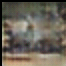

132 198
66 132


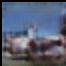

132 198
132 198


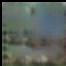

132 198
198 265


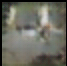

132 198
265 331


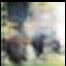

132 198
331 397


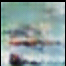

132 198
397 463


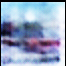

132 198
463 530


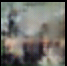

198 264
0 66


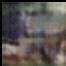

198 264
66 132


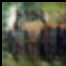

198 264
132 198


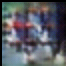

198 264
198 265


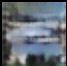

198 264
265 331


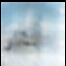

198 264
331 397


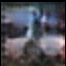

198 264
397 463


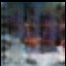

198 264
463 530


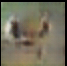

264 330
0 66


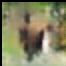

264 330
66 132


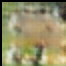

264 330
132 198


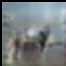

264 330
198 265


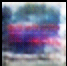

264 330
265 331


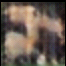

264 330
331 397


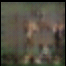

264 330
397 463


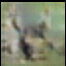

264 330
463 530


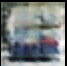

330 396
0 66


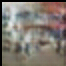

330 396
66 132


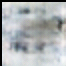

330 396
132 198


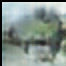

330 396
198 265


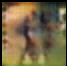

330 396
265 331


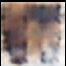

330 396
331 397


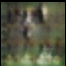

330 396
397 463


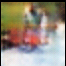

330 396
463 530


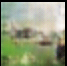

396 462
0 66


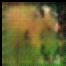

396 462
66 132


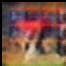

396 462
132 198


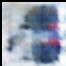

396 462
198 265


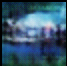

396 462
265 331


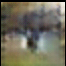

396 462
331 397


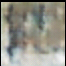

396 462
397 463


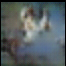

396 462
463 530


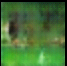

462 529
0 66


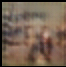

462 529
66 132


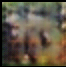

462 529
132 198


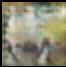

462 529
198 265


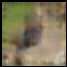

462 529
265 331


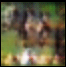

462 529
331 397


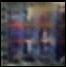

462 529
397 463


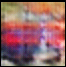

462 529
463 530


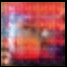

529 595
0 66


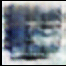

529 595
66 132


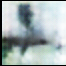

529 595
132 198


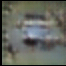

529 595
198 265


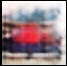

529 595
265 331


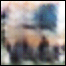

529 595
331 397


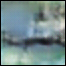

529 595
397 463


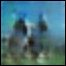

529 595
463 530


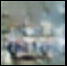

595 661
0 66


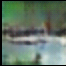

595 661
66 132


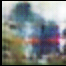

595 661
132 198


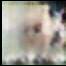

595 661
198 265


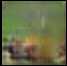

595 661
265 331


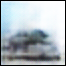

595 661
331 397


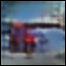

595 661
397 463


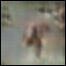

595 661
463 530


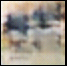

661 727
0 66


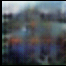

661 727
66 132


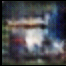

661 727
132 198


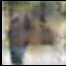

661 727
198 265


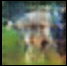

661 727
265 331


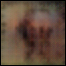

661 727
331 397


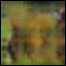

661 727
397 463


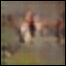

661 727
463 530


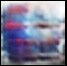

727 793
0 66


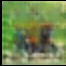

727 793
66 132


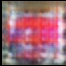

727 793
132 198


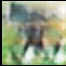

727 793
198 265


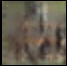

727 793
265 331


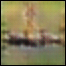

727 793
331 397


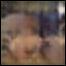

727 793
397 463


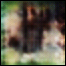

727 793
463 530


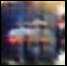

793 859
0 66


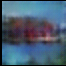

793 859
66 132


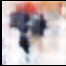

793 859
132 198


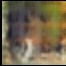

793 859
198 265


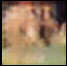

793 859
265 331


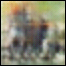

793 859
331 397


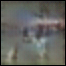

793 859
397 463


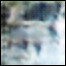

793 859
463 530


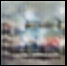

859 925
0 66


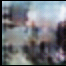

859 925
66 132


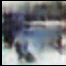

859 925
132 198


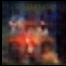

859 925
198 265


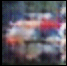

859 925
265 331


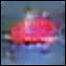

859 925
331 397


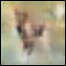

859 925
397 463


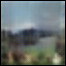

859 925
463 530


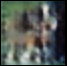

925 991
0 66


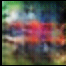

925 991
66 132


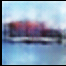

925 991
132 198


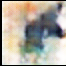

925 991
198 265


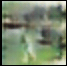

925 991
265 331


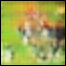

925 991
331 397


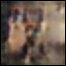

925 991
397 463


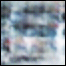

925 991
463 530


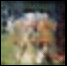

991 1058
0 66


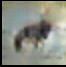

991 1058
66 132


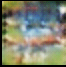

991 1058
132 198


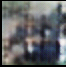

991 1058
198 265


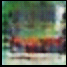

991 1058
265 331


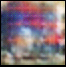

991 1058
331 397


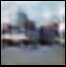

991 1058
397 463


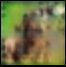

991 1058
463 530


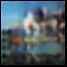

images/output/fake_samples_epoch_008.png
0 66
0 66


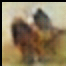

0 66
66 132


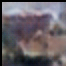

0 66
132 198


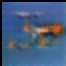

0 66
198 265


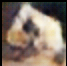

0 66
265 331


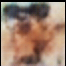

0 66
331 397


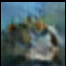

0 66
397 463


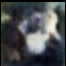

0 66
463 530


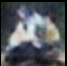

66 132
0 66


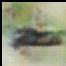

66 132
66 132


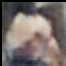

66 132
132 198


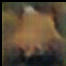

66 132
198 265


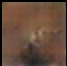

66 132
265 331


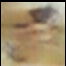

66 132
331 397


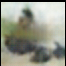

66 132
397 463


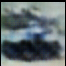

66 132
463 530


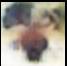

132 198
0 66


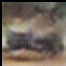

132 198
66 132


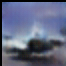

132 198
132 198


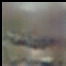

132 198
198 265


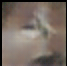

132 198
265 331


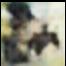

132 198
331 397


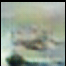

132 198
397 463


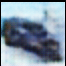

132 198
463 530


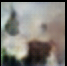

198 264
0 66


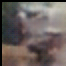

198 264
66 132


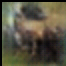

198 264
132 198


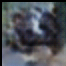

198 264
198 265


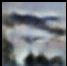

198 264
265 331


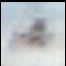

198 264
331 397


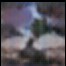

198 264
397 463


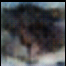

198 264
463 530


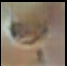

264 330
0 66


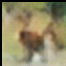

264 330
66 132


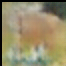

264 330
132 198


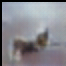

264 330
198 265


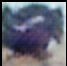

264 330
265 331


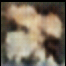

264 330
331 397


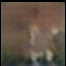

264 330
397 463


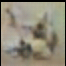

264 330
463 530


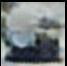

330 396
0 66


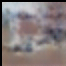

330 396
66 132


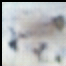

330 396
132 198


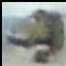

330 396
198 265


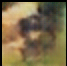

330 396
265 331


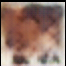

330 396
331 397


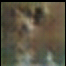

330 396
397 463


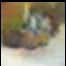

330 396
463 530


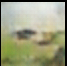

396 462
0 66


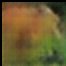

396 462
66 132


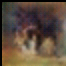

396 462
132 198


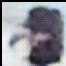

396 462
198 265


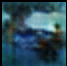

396 462
265 331


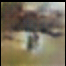

396 462
331 397


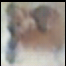

396 462
397 463


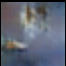

396 462
463 530


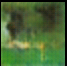

462 529
0 66


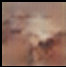

462 529
66 132


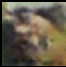

462 529
132 198


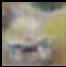

462 529
198 265


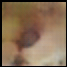

462 529
265 331


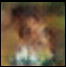

462 529
331 397


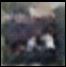

462 529
397 463


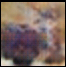

462 529
463 530


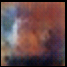

529 595
0 66


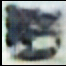

529 595
66 132


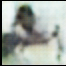

529 595
132 198


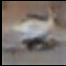

529 595
198 265


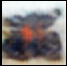

529 595
265 331


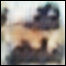

529 595
331 397


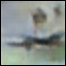

529 595
397 463


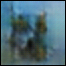

529 595
463 530


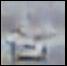

595 661
0 66


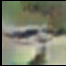

595 661
66 132


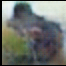

595 661
132 198


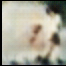

595 661
198 265


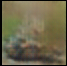

595 661
265 331


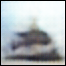

595 661
331 397


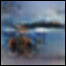

595 661
397 463


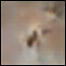

595 661
463 530


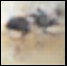

661 727
0 66


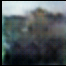

661 727
66 132


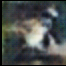

661 727
132 198


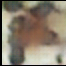

661 727
198 265


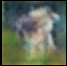

661 727
265 331


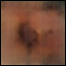

661 727
331 397


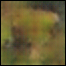

661 727
397 463


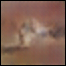

661 727
463 530


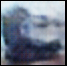

727 793
0 66


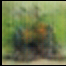

727 793
66 132


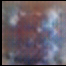

727 793
132 198


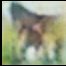

727 793
198 265


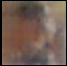

727 793
265 331


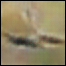

727 793
331 397


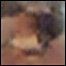

727 793
397 463


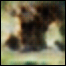

727 793
463 530


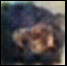

793 859
0 66


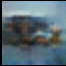

793 859
66 132


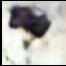

793 859
132 198


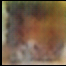

793 859
198 265


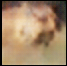

793 859
265 331


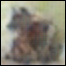

793 859
331 397


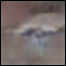

793 859
397 463


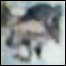

793 859
463 530


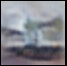

859 925
0 66


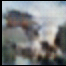

859 925
66 132


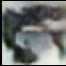

859 925
132 198


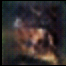

859 925
198 265


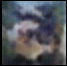

859 925
265 331


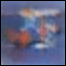

859 925
331 397


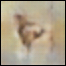

859 925
397 463


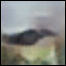

859 925
463 530


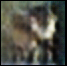

925 991
0 66


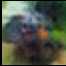

925 991
66 132


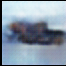

925 991
132 198


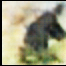

925 991
198 265


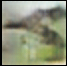

925 991
265 331


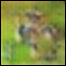

925 991
331 397


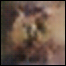

925 991
397 463


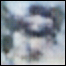

925 991
463 530


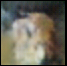

991 1058
0 66


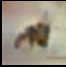

991 1058
66 132


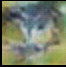

991 1058
132 198


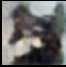

991 1058
198 265


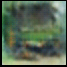

991 1058
265 331


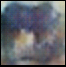

991 1058
331 397


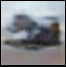

991 1058
397 463


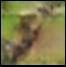

991 1058
463 530


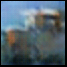

images/output/fake_samples_epoch_009.png
0 66
0 66


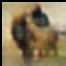

0 66
66 132


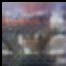

0 66
132 198


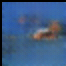

0 66
198 265


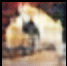

0 66
265 331


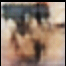

0 66
331 397


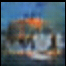

0 66
397 463


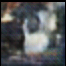

0 66
463 530


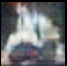

66 132
0 66


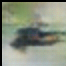

66 132
66 132


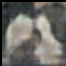

66 132
132 198


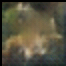

66 132
198 265


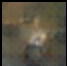

66 132
265 331


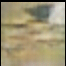

66 132
331 397


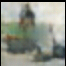

66 132
397 463


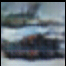

66 132
463 530


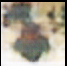

132 198
0 66


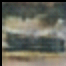

132 198
66 132


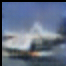

132 198
132 198


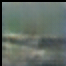

132 198
198 265


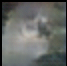

132 198
265 331


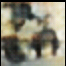

132 198
331 397


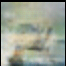

132 198
397 463


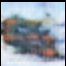

132 198
463 530


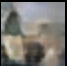

198 264
0 66


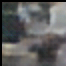

198 264
66 132


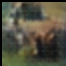

198 264
132 198


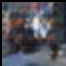

198 264
198 265


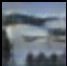

198 264
265 331


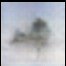

198 264
331 397


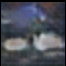

198 264
397 463


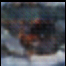

198 264
463 530


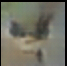

264 330
0 66


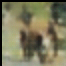

264 330
66 132


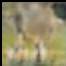

264 330
132 198


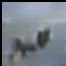

264 330
198 265


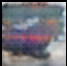

264 330
265 331


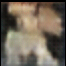

264 330
331 397


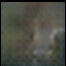

264 330
397 463


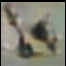

264 330
463 530


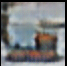

330 396
0 66


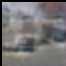

330 396
66 132


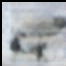

330 396
132 198


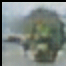

330 396
198 265


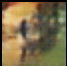

330 396
265 331


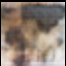

330 396
331 397


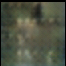

330 396
397 463


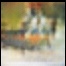

330 396
463 530


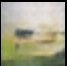

396 462
0 66


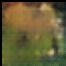

396 462
66 132


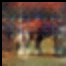

396 462
132 198


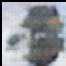

396 462
198 265


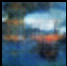

396 462
265 331


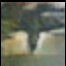

396 462
331 397


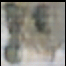

396 462
397 463


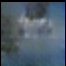

396 462
463 530


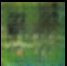

462 529
0 66


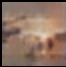

462 529
66 132


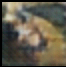

462 529
132 198


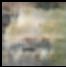

462 529
198 265


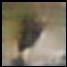

462 529
265 331


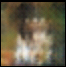

462 529
331 397


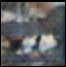

462 529
397 463


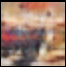

462 529
463 530


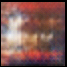

529 595
0 66


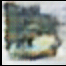

529 595
66 132


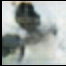

529 595
132 198


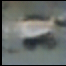

529 595
198 265


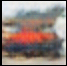

529 595
265 331


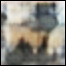

529 595
331 397


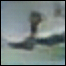

529 595
397 463


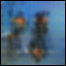

529 595
463 530


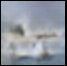

595 661
0 66


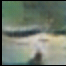

595 661
66 132


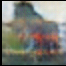

595 661
132 198


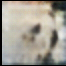

595 661
198 265


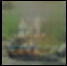

595 661
265 331


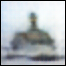

595 661
331 397


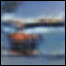

595 661
397 463


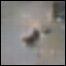

595 661
463 530


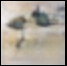

661 727
0 66


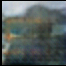

661 727
66 132


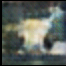

661 727
132 198


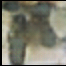

661 727
198 265


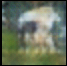

661 727
265 331


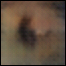

661 727
331 397


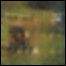

661 727
397 463


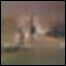

661 727
463 530


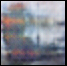

727 793
0 66


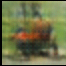

727 793
66 132


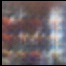

727 793
132 198


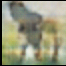

727 793
198 265


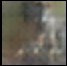

727 793
265 331


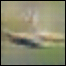

727 793
331 397


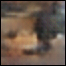

727 793
397 463


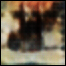

727 793
463 530


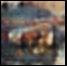

793 859
0 66


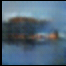

793 859
66 132


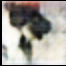

793 859
132 198


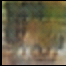

793 859
198 265


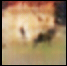

793 859
265 331


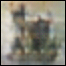

793 859
331 397


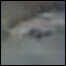

793 859
397 463


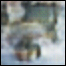

793 859
463 530


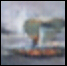

859 925
0 66


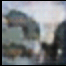

859 925
66 132


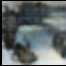

859 925
132 198


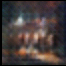

859 925
198 265


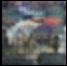

859 925
265 331


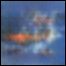

859 925
331 397


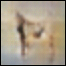

859 925
397 463


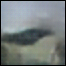

859 925
463 530


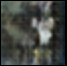

925 991
0 66


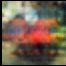

925 991
66 132


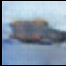

925 991
132 198


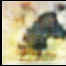

925 991
198 265


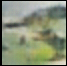

925 991
265 331


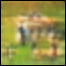

925 991
331 397


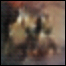

925 991
397 463


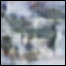

925 991
463 530


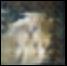

991 1058
0 66


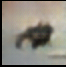

991 1058
66 132


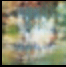

991 1058
132 198


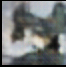

991 1058
198 265


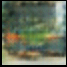

991 1058
265 331


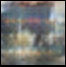

991 1058
331 397


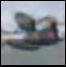

991 1058
397 463


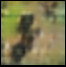

991 1058
463 530


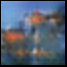

images/output/fake_samples_epoch_010.png
0 66
0 66


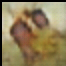

0 66
66 132


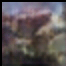

0 66
132 198


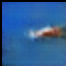

0 66
198 265


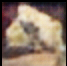

0 66
265 331


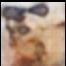

0 66
331 397


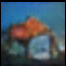

0 66
397 463


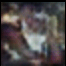

0 66
463 530


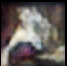

66 132
0 66


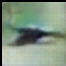

66 132
66 132


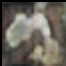

66 132
132 198


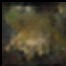

66 132
198 265


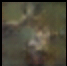

66 132
265 331


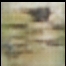

66 132
331 397


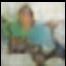

66 132
397 463


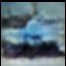

66 132
463 530


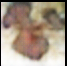

132 198
0 66


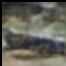

132 198
66 132


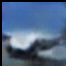

132 198
132 198


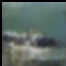

132 198
198 265


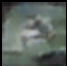

132 198
265 331


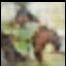

132 198
331 397


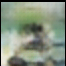

132 198
397 463


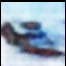

132 198
463 530


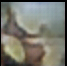

198 264
0 66


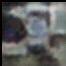

198 264
66 132


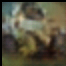

198 264
132 198


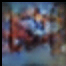

198 264
198 265


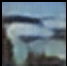

198 264
265 331


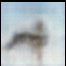

198 264
331 397


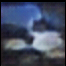

198 264
397 463


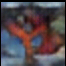

198 264
463 530


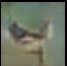

264 330
0 66


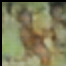

264 330
66 132


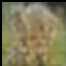

264 330
132 198


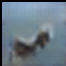

264 330
198 265


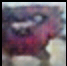

264 330
265 331


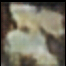

264 330
331 397


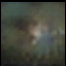

264 330
397 463


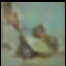

264 330
463 530


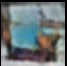

330 396
0 66


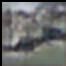

330 396
66 132


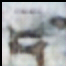

330 396
132 198


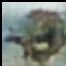

330 396
198 265


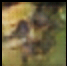

330 396
265 331


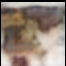

330 396
331 397


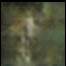

330 396
397 463


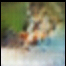

330 396
463 530


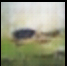

396 462
0 66


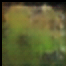

396 462
66 132


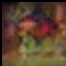

396 462
132 198


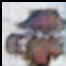

396 462
198 265


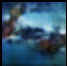

396 462
265 331


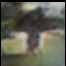

396 462
331 397


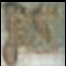

396 462
397 463


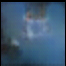

396 462
463 530


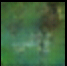

462 529
0 66


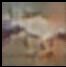

462 529
66 132


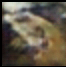

462 529
132 198


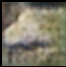

462 529
198 265


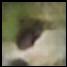

462 529
265 331


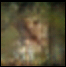

462 529
331 397


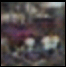

462 529
397 463


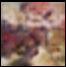

462 529
463 530


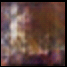

529 595
0 66


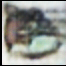

529 595
66 132


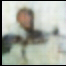

529 595
132 198


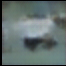

529 595
198 265


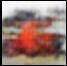

529 595
265 331


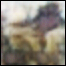

529 595
331 397


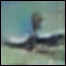

529 595
397 463


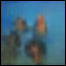

529 595
463 530


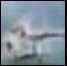

595 661
0 66


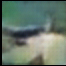

595 661
66 132


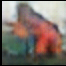

595 661
132 198


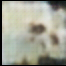

595 661
198 265


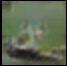

595 661
265 331


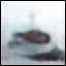

595 661
331 397


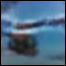

595 661
397 463


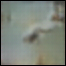

595 661
463 530


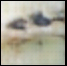

661 727
0 66


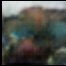

661 727
66 132


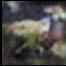

661 727
132 198


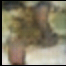

661 727
198 265


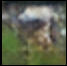

661 727
265 331


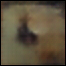

661 727
331 397


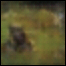

661 727
397 463


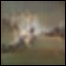

661 727
463 530


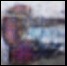

727 793
0 66


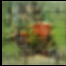

727 793
66 132


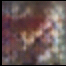

727 793
132 198


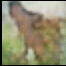

727 793
198 265


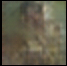

727 793
265 331


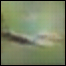

727 793
331 397


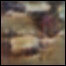

727 793
397 463


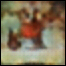

727 793
463 530


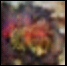

793 859
0 66


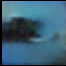

793 859
66 132


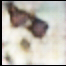

793 859
132 198


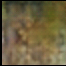

793 859
198 265


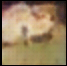

793 859
265 331


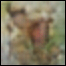

793 859
331 397


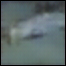

793 859
397 463


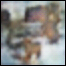

793 859
463 530


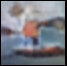

859 925
0 66


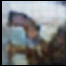

859 925
66 132


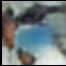

859 925
132 198


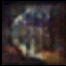

859 925
198 265


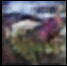

859 925
265 331


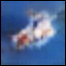

859 925
331 397


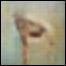

859 925
397 463


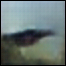

859 925
463 530


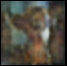

925 991
0 66


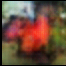

925 991
66 132


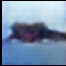

925 991
132 198


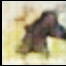

925 991
198 265


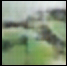

925 991
265 331


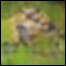

925 991
331 397


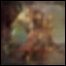

925 991
397 463


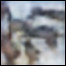

925 991
463 530


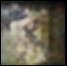

991 1058
0 66


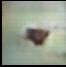

991 1058
66 132


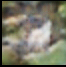

991 1058
132 198


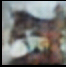

991 1058
198 265


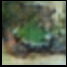

991 1058
265 331


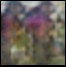

991 1058
331 397


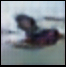

991 1058
397 463


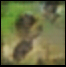

991 1058
463 530


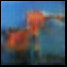

images/output/fake_samples_epoch_011.png
0 66
0 66


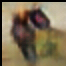

0 66
66 132


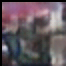

0 66
132 198


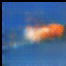

0 66
198 265


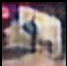

0 66
265 331


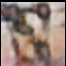

0 66
331 397


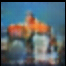

0 66
397 463


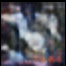

0 66
463 530


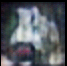

66 132
0 66


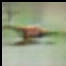

66 132
66 132


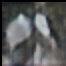

66 132
132 198


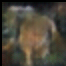

66 132
198 265


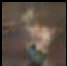

66 132
265 331


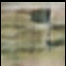

66 132
331 397


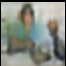

66 132
397 463


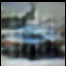

66 132
463 530


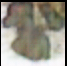

132 198
0 66


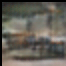

132 198
66 132


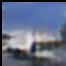

132 198
132 198


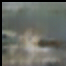

132 198
198 265


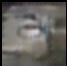

132 198
265 331


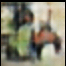

132 198
331 397


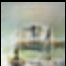

132 198
397 463


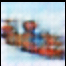

132 198
463 530


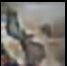

198 264
0 66


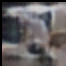

198 264
66 132


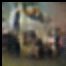

198 264
132 198


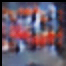

198 264
198 265


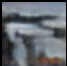

198 264
265 331


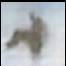

198 264
331 397


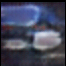

198 264
397 463


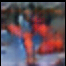

198 264
463 530


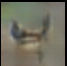

264 330
0 66


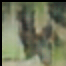

264 330
66 132


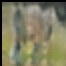

264 330
132 198


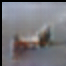

264 330
198 265


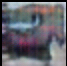

264 330
265 331


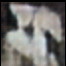

264 330
331 397


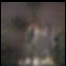

264 330
397 463


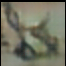

264 330
463 530


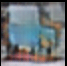

330 396
0 66


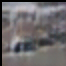

330 396
66 132


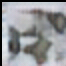

330 396
132 198


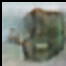

330 396
198 265


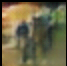

330 396
265 331


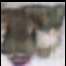

330 396
331 397


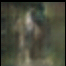

330 396
397 463


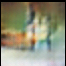

330 396
463 530


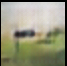

396 462
0 66


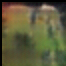

396 462
66 132


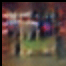

396 462
132 198


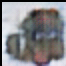

396 462
198 265


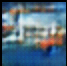

396 462
265 331


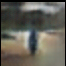

396 462
331 397


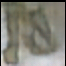

396 462
397 463


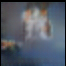

396 462
463 530


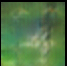

462 529
0 66


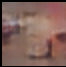

462 529
66 132


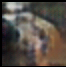

462 529
132 198


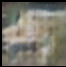

462 529
198 265


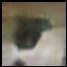

462 529
265 331


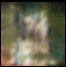

462 529
331 397


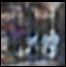

462 529
397 463


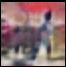

462 529
463 530


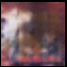

529 595
0 66


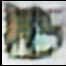

529 595
66 132


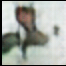

529 595
132 198


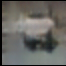

529 595
198 265


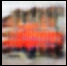

529 595
265 331


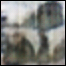

529 595
331 397


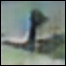

529 595
397 463


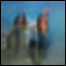

529 595
463 530


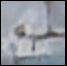

595 661
0 66


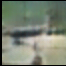

595 661
66 132


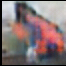

595 661
132 198


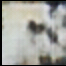

595 661
198 265


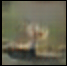

595 661
265 331


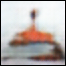

595 661
331 397


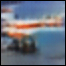

595 661
397 463


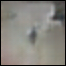

595 661
463 530


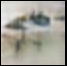

661 727
0 66


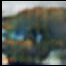

661 727
66 132


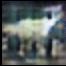

661 727
132 198


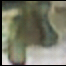

661 727
198 265


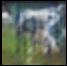

661 727
265 331


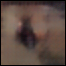

661 727
331 397


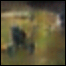

661 727
397 463


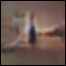

661 727
463 530


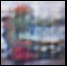

727 793
0 66


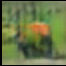

727 793
66 132


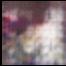

727 793
132 198


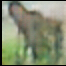

727 793
198 265


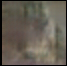

727 793
265 331


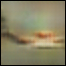

727 793
331 397


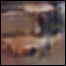

727 793
397 463


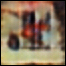

727 793
463 530


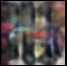

793 859
0 66


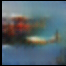

793 859
66 132


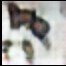

793 859
132 198


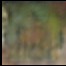

793 859
198 265


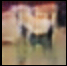

793 859
265 331


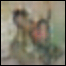

793 859
331 397


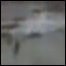

793 859
397 463


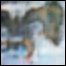

793 859
463 530


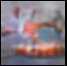

859 925
0 66


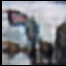

859 925
66 132


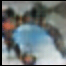

859 925
132 198


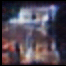

859 925
198 265


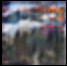

859 925
265 331


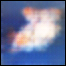

859 925
331 397


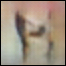

859 925
397 463


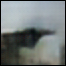

859 925
463 530


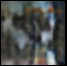

925 991
0 66


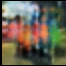

925 991
66 132


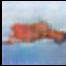

925 991
132 198


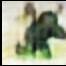

925 991
198 265


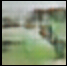

925 991
265 331


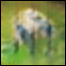

925 991
331 397


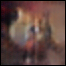

925 991
397 463


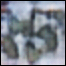

925 991
463 530


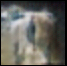

991 1058
0 66


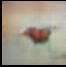

991 1058
66 132


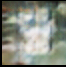

991 1058
132 198


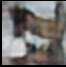

991 1058
198 265


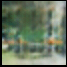

991 1058
265 331


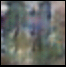

991 1058
331 397


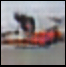

991 1058
397 463


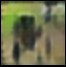

991 1058
463 530


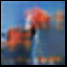

images/output/fake_samples_epoch_012.png
0 66
0 66


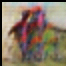

0 66
66 132


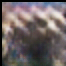

0 66
132 198


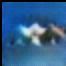

0 66
198 265


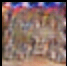

0 66
265 331


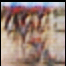

0 66
331 397


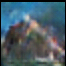

0 66
397 463


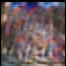

0 66
463 530


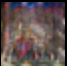

66 132
0 66


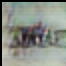

66 132
66 132


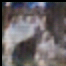

66 132
132 198


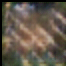

66 132
198 265


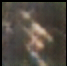

66 132
265 331


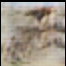

66 132
331 397


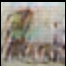

66 132
397 463


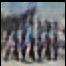

66 132
463 530


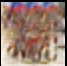

132 198
0 66


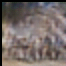

132 198
66 132


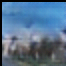

132 198
132 198


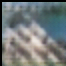

132 198
198 265


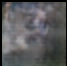

132 198
265 331


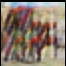

132 198
331 397


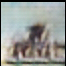

132 198
397 463


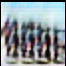

132 198
463 530


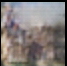

198 264
0 66


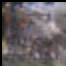

198 264
66 132


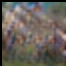

198 264
132 198


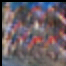

198 264
198 265


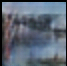

198 264
265 331


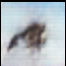

198 264
331 397


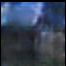

198 264
397 463


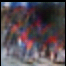

198 264
463 530


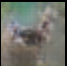

264 330
0 66


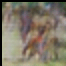

264 330
66 132


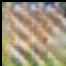

264 330
132 198


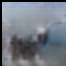

264 330
198 265


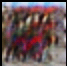

264 330
265 331


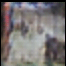

264 330
331 397


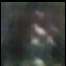

264 330
397 463


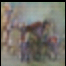

264 330
463 530


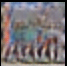

330 396
0 66


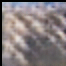

330 396
66 132


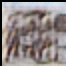

330 396
132 198


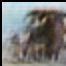

330 396
198 265


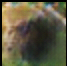

330 396
265 331


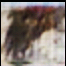

330 396
331 397


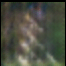

330 396
397 463


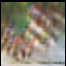

330 396
463 530


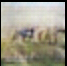

396 462
0 66


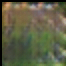

396 462
66 132


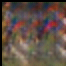

396 462
132 198


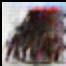

396 462
198 265


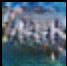

396 462
265 331


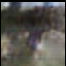

396 462
331 397


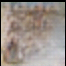

396 462
397 463


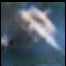

396 462
463 530


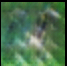

462 529
0 66


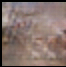

462 529
66 132


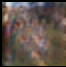

462 529
132 198


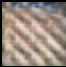

462 529
198 265


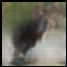

462 529
265 331


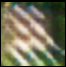

462 529
331 397


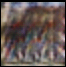

462 529
397 463


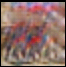

462 529
463 530


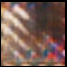

529 595
0 66


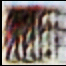

529 595
66 132


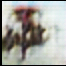

529 595
132 198


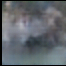

529 595
198 265


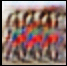

529 595
265 331


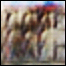

529 595
331 397


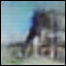

529 595
397 463


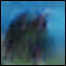

529 595
463 530


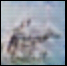

595 661
0 66


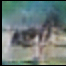

595 661
66 132


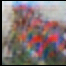

595 661
132 198


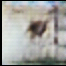

595 661
198 265


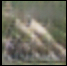

595 661
265 331


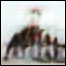

595 661
331 397


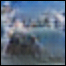

595 661
397 463


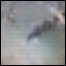

595 661
463 530


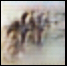

661 727
0 66


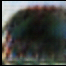

661 727
66 132


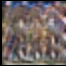

661 727
132 198


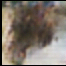

661 727
198 265


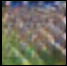

661 727
265 331


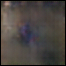

661 727
331 397


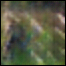

661 727
397 463


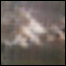

661 727
463 530


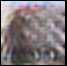

727 793
0 66


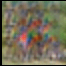

727 793
66 132


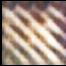

727 793
132 198


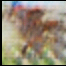

727 793
198 265


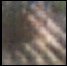

727 793
265 331


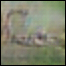

727 793
331 397


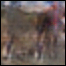

727 793
397 463


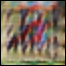

727 793
463 530


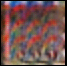

793 859
0 66


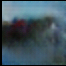

793 859
66 132


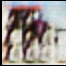

793 859
132 198


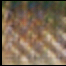

793 859
198 265


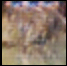

793 859
265 331


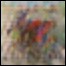

793 859
331 397


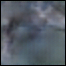

793 859
397 463


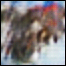

793 859
463 530


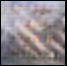

859 925
0 66


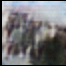

859 925
66 132


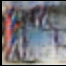

859 925
132 198


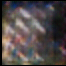

859 925
198 265


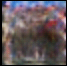

859 925
265 331


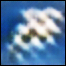

859 925
331 397


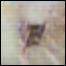

859 925
397 463


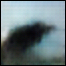

859 925
463 530


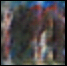

925 991
0 66


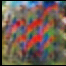

925 991
66 132


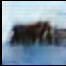

925 991
132 198


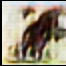

925 991
198 265


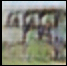

925 991
265 331


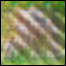

925 991
331 397


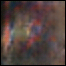

925 991
397 463


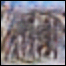

925 991
463 530


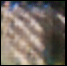

991 1058
0 66


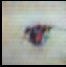

991 1058
66 132


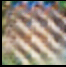

991 1058
132 198


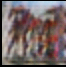

991 1058
198 265


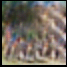

991 1058
265 331


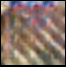

991 1058
331 397


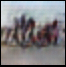

991 1058
397 463


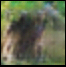

991 1058
463 530


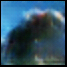

images/output/fake_samples_epoch_013.png
0 66
0 66


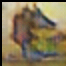

0 66
66 132


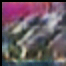

0 66
132 198


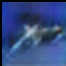

0 66
198 265


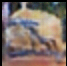

0 66
265 331


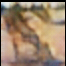

0 66
331 397


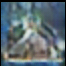

0 66
397 463


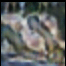

0 66
463 530


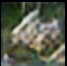

66 132
0 66


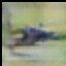

66 132
66 132


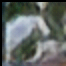

66 132
132 198


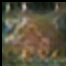

66 132
198 265


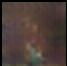

66 132
265 331


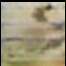

66 132
331 397


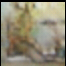

66 132
397 463


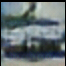

66 132
463 530


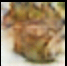

132 198
0 66


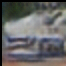

132 198
66 132


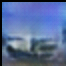

132 198
132 198


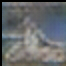

132 198
198 265


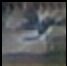

132 198
265 331


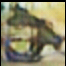

132 198
331 397


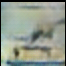

132 198
397 463


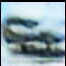

132 198
463 530


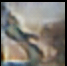

198 264
0 66


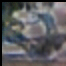

198 264
66 132


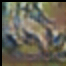

198 264
132 198


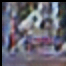

198 264
198 265


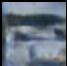

198 264
265 331


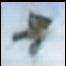

198 264
331 397


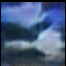

198 264
397 463


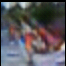

198 264
463 530


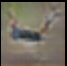

264 330
0 66


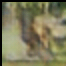

264 330
66 132


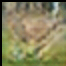

264 330
132 198


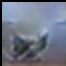

264 330
198 265


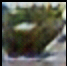

264 330
265 331


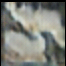

264 330
331 397


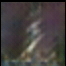

264 330
397 463


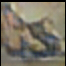

264 330
463 530


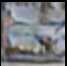

330 396
0 66


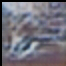

330 396
66 132


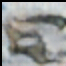

330 396
132 198


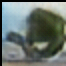

330 396
198 265


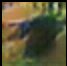

330 396
265 331


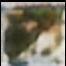

330 396
331 397


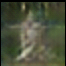

330 396
397 463


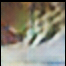

330 396
463 530


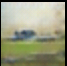

396 462
0 66


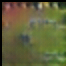

396 462
66 132


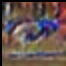

396 462
132 198


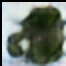

396 462
198 265


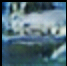

396 462
265 331


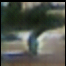

396 462
331 397


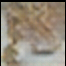

396 462
397 463


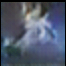

396 462
463 530


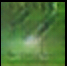

462 529
0 66


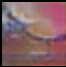

462 529
66 132


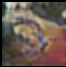

462 529
132 198


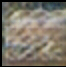

462 529
198 265


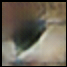

462 529
265 331


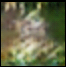

462 529
331 397


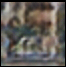

462 529
397 463


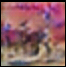

462 529
463 530


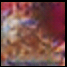

529 595
0 66


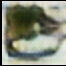

529 595
66 132


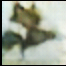

529 595
132 198


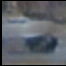

529 595
198 265


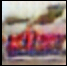

529 595
265 331


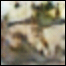

529 595
331 397


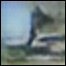

529 595
397 463


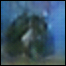

529 595
463 530


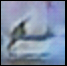

595 661
0 66


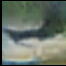

595 661
66 132


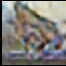

595 661
132 198


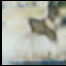

595 661
198 265


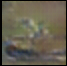

595 661
265 331


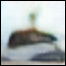

595 661
331 397


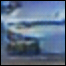

595 661
397 463


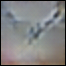

595 661
463 530


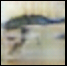

661 727
0 66


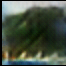

661 727
66 132


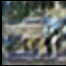

661 727
132 198


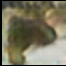

661 727
198 265


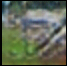

661 727
265 331


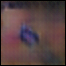

661 727
331 397


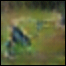

661 727
397 463


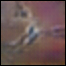

661 727
463 530


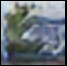

727 793
0 66


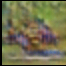

727 793
66 132


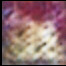

727 793
132 198


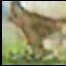

727 793
198 265


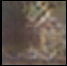

727 793
265 331


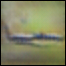

727 793
331 397


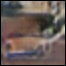

727 793
397 463


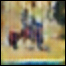

727 793
463 530


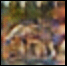

793 859
0 66


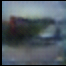

793 859
66 132


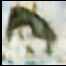

793 859
132 198


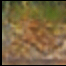

793 859
198 265


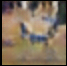

793 859
265 331


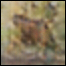

793 859
331 397


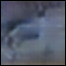

793 859
397 463


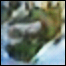

793 859
463 530


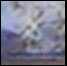

859 925
0 66


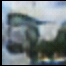

859 925
66 132


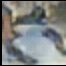

859 925
132 198


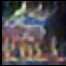

859 925
198 265


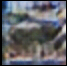

859 925
265 331


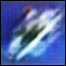

859 925
331 397


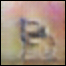

859 925
397 463


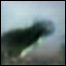

859 925
463 530


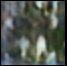

925 991
0 66


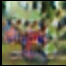

925 991
66 132


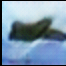

925 991
132 198


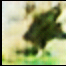

925 991
198 265


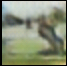

925 991
265 331


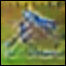

925 991
331 397


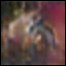

925 991
397 463


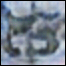

925 991
463 530


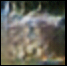

991 1058
0 66


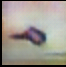

991 1058
66 132


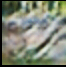

991 1058
132 198


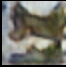

991 1058
198 265


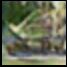

991 1058
265 331


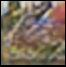

991 1058
331 397


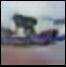

991 1058
397 463


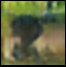

991 1058
463 530


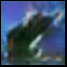

images/output/fake_samples_epoch_014.png
0 66
0 66


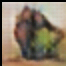

0 66
66 132


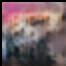

0 66
132 198


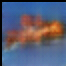

0 66
198 265


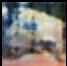

0 66
265 331


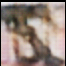

0 66
331 397


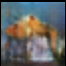

0 66
397 463


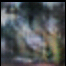

0 66
463 530


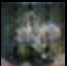

66 132
0 66


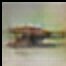

66 132
66 132


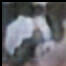

66 132
132 198


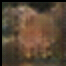

66 132
198 265


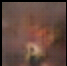

66 132
265 331


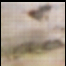

66 132
331 397


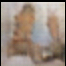

66 132
397 463


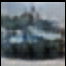

66 132
463 530


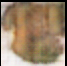

132 198
0 66


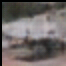

132 198
66 132


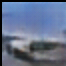

132 198
132 198


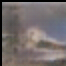

132 198
198 265


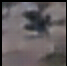

132 198
265 331


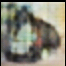

132 198
331 397


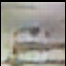

132 198
397 463


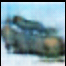

132 198
463 530


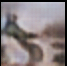

198 264
0 66


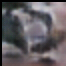

198 264
66 132


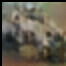

198 264
132 198


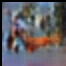

198 264
198 265


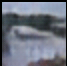

198 264
265 331


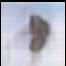

198 264
331 397


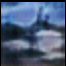

198 264
397 463


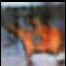

198 264
463 530


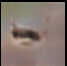

264 330
0 66


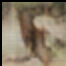

264 330
66 132


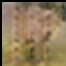

264 330
132 198


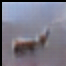

264 330
198 265


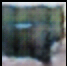

264 330
265 331


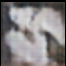

264 330
331 397


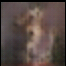

264 330
397 463


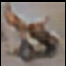

264 330
463 530


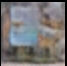

330 396
0 66


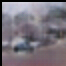

330 396
66 132


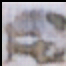

330 396
132 198


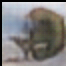

330 396
198 265


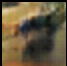

330 396
265 331


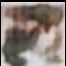

330 396
331 397


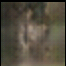

330 396
397 463


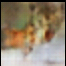

330 396
463 530


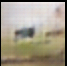

396 462
0 66


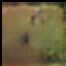

396 462
66 132


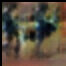

396 462
132 198


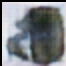

396 462
198 265


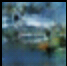

396 462
265 331


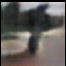

396 462
331 397


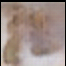

396 462
397 463


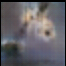

396 462
463 530


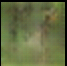

462 529
0 66


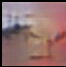

462 529
66 132


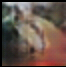

462 529
132 198


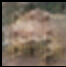

462 529
198 265


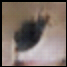

462 529
265 331


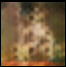

462 529
331 397


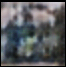

462 529
397 463


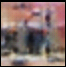

462 529
463 530


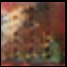

529 595
0 66


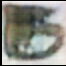

529 595
66 132


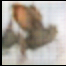

529 595
132 198


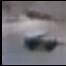

529 595
198 265


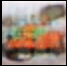

529 595
265 331


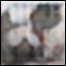

529 595
331 397


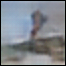

529 595
397 463


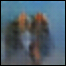

529 595
463 530


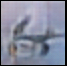

595 661
0 66


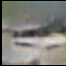

595 661
66 132


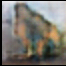

595 661
132 198


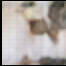

595 661
198 265


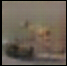

595 661
265 331


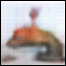

595 661
331 397


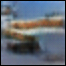

595 661
397 463


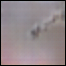

595 661
463 530


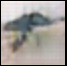

661 727
0 66


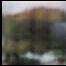

661 727
66 132


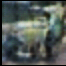

661 727
132 198


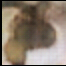

661 727
198 265


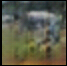

661 727
265 331


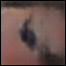

661 727
331 397


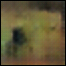

661 727
397 463


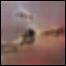

661 727
463 530


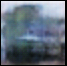

727 793
0 66


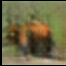

727 793
66 132


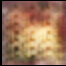

727 793
132 198


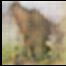

727 793
198 265


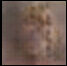

727 793
265 331


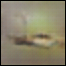

727 793
331 397


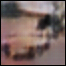

727 793
397 463


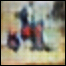

727 793
463 530


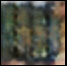

793 859
0 66


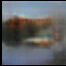

793 859
66 132


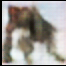

793 859
132 198


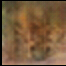

793 859
198 265


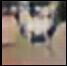

793 859
265 331


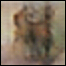

793 859
331 397


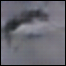

793 859
397 463


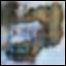

793 859
463 530


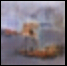

859 925
0 66


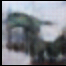

859 925
66 132


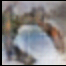

859 925
132 198


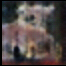

859 925
198 265


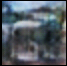

859 925
265 331


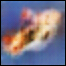

859 925
331 397


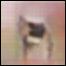

859 925
397 463


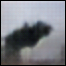

859 925
463 530


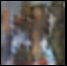

925 991
0 66


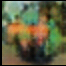

925 991
66 132


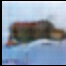

925 991
132 198


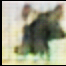

925 991
198 265


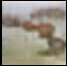

925 991
265 331


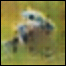

925 991
331 397


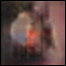

925 991
397 463


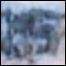

925 991
463 530


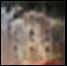

991 1058
0 66


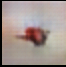

991 1058
66 132


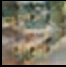

991 1058
132 198


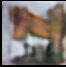

991 1058
198 265


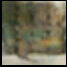

991 1058
265 331


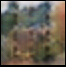

991 1058
331 397


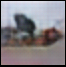

991 1058
397 463


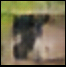

991 1058
463 530


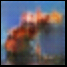

images/output/fake_samples_epoch_015.png
0 66
0 66


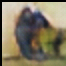

0 66
66 132


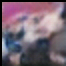

0 66
132 198


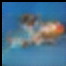

0 66
198 265


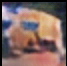

0 66
265 331


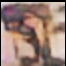

0 66
331 397


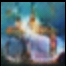

0 66
397 463


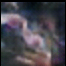

0 66
463 530


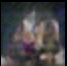

66 132
0 66


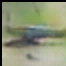

66 132
66 132


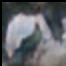

66 132
132 198


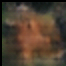

66 132
198 265


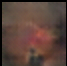

66 132
265 331


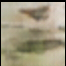

66 132
331 397


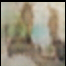

66 132
397 463


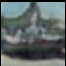

66 132
463 530


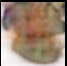

132 198
0 66


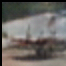

132 198
66 132


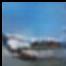

132 198
132 198


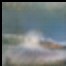

132 198
198 265


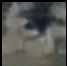

132 198
265 331


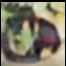

132 198
331 397


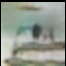

132 198
397 463


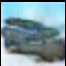

132 198
463 530


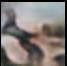

198 264
0 66


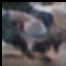

198 264
66 132


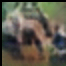

198 264
132 198


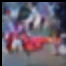

198 264
198 265


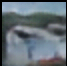

198 264
265 331


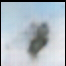

198 264
331 397


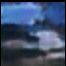

198 264
397 463


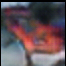

198 264
463 530


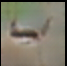

264 330
0 66


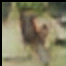

264 330
66 132


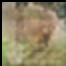

264 330
132 198


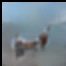

264 330
198 265


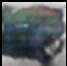

264 330
265 331


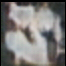

264 330
331 397


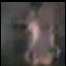

264 330
397 463


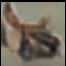

264 330
463 530


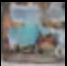

330 396
0 66


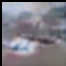

330 396
66 132


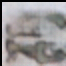

330 396
132 198


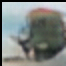

330 396
198 265


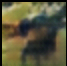

330 396
265 331


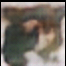

330 396
331 397


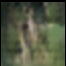

330 396
397 463


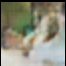

330 396
463 530


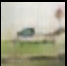

396 462
0 66


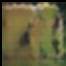

396 462
66 132


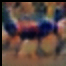

396 462
132 198


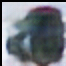

396 462
198 265


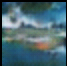

396 462
265 331


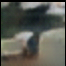

396 462
331 397


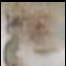

396 462
397 463


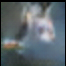

396 462
463 530


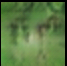

462 529
0 66


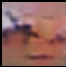

462 529
66 132


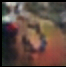

462 529
132 198


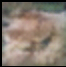

462 529
198 265


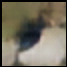

462 529
265 331


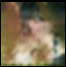

462 529
331 397


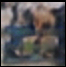

462 529
397 463


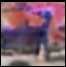

462 529
463 530


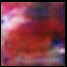

529 595
0 66


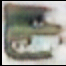

529 595
66 132


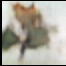

529 595
132 198


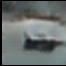

529 595
198 265


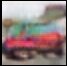

529 595
265 331


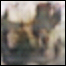

529 595
331 397


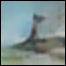

529 595
397 463


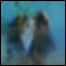

529 595
463 530


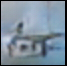

595 661
0 66


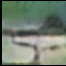

595 661
66 132


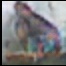

595 661
132 198


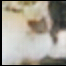

595 661
198 265


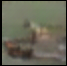

595 661
265 331


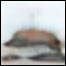

595 661
331 397


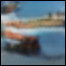

595 661
397 463


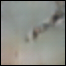

595 661
463 530


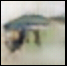

661 727
0 66


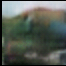

661 727
66 132


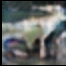

661 727
132 198


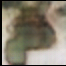

661 727
198 265


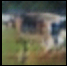

661 727
265 331


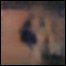

661 727
331 397


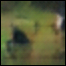

661 727
397 463


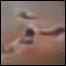

661 727
463 530


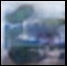

727 793
0 66


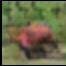

727 793
66 132


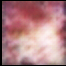

727 793
132 198


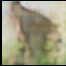

727 793
198 265


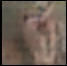

727 793
265 331


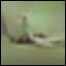

727 793
331 397


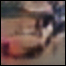

727 793
397 463


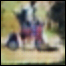

727 793
463 530


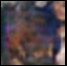

793 859
0 66


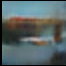

793 859
66 132


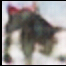

793 859
132 198


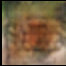

793 859
198 265


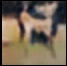

793 859
265 331


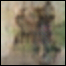

793 859
331 397


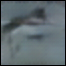

793 859
397 463


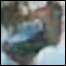

793 859
463 530


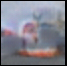

859 925
0 66


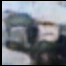

859 925
66 132


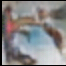

859 925
132 198


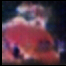

859 925
198 265


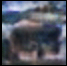

859 925
265 331


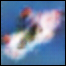

859 925
331 397


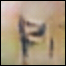

859 925
397 463


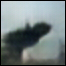

859 925
463 530


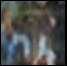

925 991
0 66


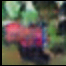

925 991
66 132


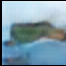

925 991
132 198


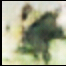

925 991
198 265


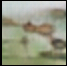

925 991
265 331


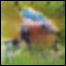

925 991
331 397


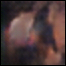

925 991
397 463


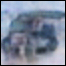

925 991
463 530


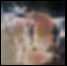

991 1058
0 66


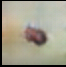

991 1058
66 132


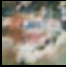

991 1058
132 198


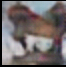

991 1058
198 265


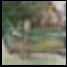

991 1058
265 331


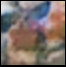

991 1058
331 397


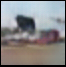

991 1058
397 463


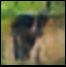

991 1058
463 530


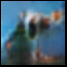

images/output/fake_samples_epoch_016.png
0 66
0 66


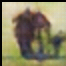

0 66
66 132


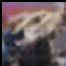

0 66
132 198


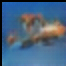

0 66
198 265


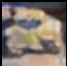

0 66
265 331


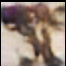

0 66
331 397


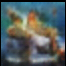

0 66
397 463


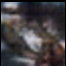

0 66
463 530


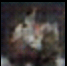

66 132
0 66


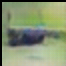

66 132
66 132


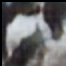

66 132
132 198


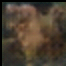

66 132
198 265


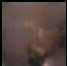

66 132
265 331


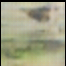

66 132
331 397


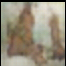

66 132
397 463


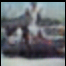

66 132
463 530


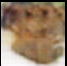

132 198
0 66


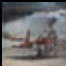

132 198
66 132


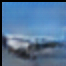

132 198
132 198


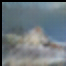

132 198
198 265


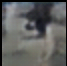

132 198
265 331


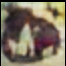

132 198
331 397


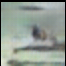

132 198
397 463


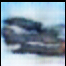

132 198
463 530


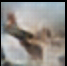

198 264
0 66


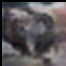

198 264
66 132


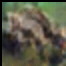

198 264
132 198


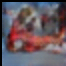

198 264
198 265


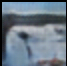

198 264
265 331


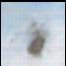

198 264
331 397


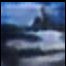

198 264
397 463


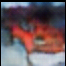

198 264
463 530


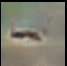

264 330
0 66


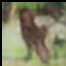

264 330
66 132


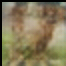

264 330
132 198


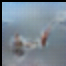

264 330
198 265


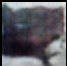

264 330
265 331


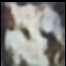

264 330
331 397


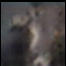

264 330
397 463


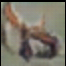

264 330
463 530


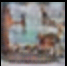

330 396
0 66


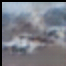

330 396
66 132


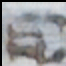

330 396
132 198


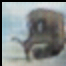

330 396
198 265


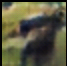

330 396
265 331


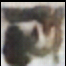

330 396
331 397


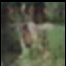

330 396
397 463


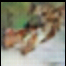

330 396
463 530


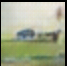

396 462
0 66


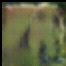

396 462
66 132


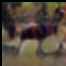

396 462
132 198


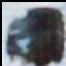

396 462
198 265


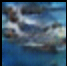

396 462
265 331


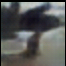

396 462
331 397


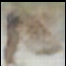

396 462
397 463


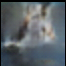

396 462
463 530


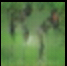

462 529
0 66


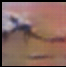

462 529
66 132


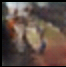

462 529
132 198


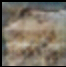

462 529
198 265


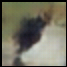

462 529
265 331


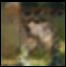

462 529
331 397


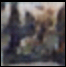

462 529
397 463


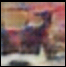

462 529
463 530


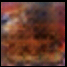

529 595
0 66


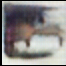

529 595
66 132


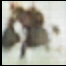

529 595
132 198


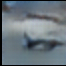

529 595
198 265


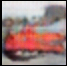

529 595
265 331


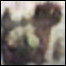

529 595
331 397


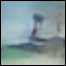

529 595
397 463


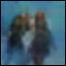

529 595
463 530


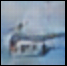

595 661
0 66


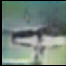

595 661
66 132


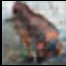

595 661
132 198


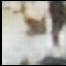

595 661
198 265


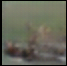

595 661
265 331


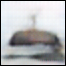

595 661
331 397


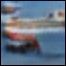

595 661
397 463


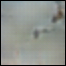

595 661
463 530


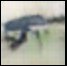

661 727
0 66


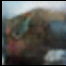

661 727
66 132


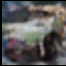

661 727
132 198


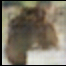

661 727
198 265


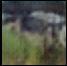

661 727
265 331


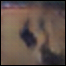

661 727
331 397


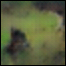

661 727
397 463


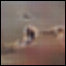

661 727
463 530


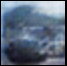

727 793
0 66


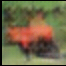

727 793
66 132


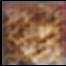

727 793
132 198


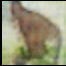

727 793
198 265


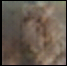

727 793
265 331


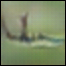

727 793
331 397


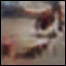

727 793
397 463


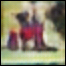

727 793
463 530


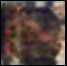

793 859
0 66


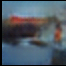

793 859
66 132


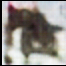

793 859
132 198


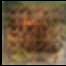

793 859
198 265


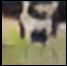

793 859
265 331


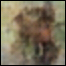

793 859
331 397


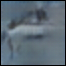

793 859
397 463


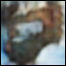

793 859
463 530


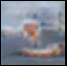

859 925
0 66


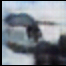

859 925
66 132


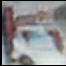

859 925
132 198


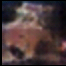

859 925
198 265


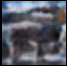

859 925
265 331


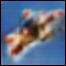

859 925
331 397


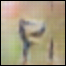

859 925
397 463


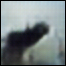

859 925
463 530


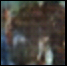

925 991
0 66


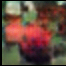

925 991
66 132


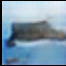

925 991
132 198


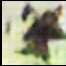

925 991
198 265


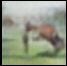

925 991
265 331


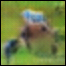

925 991
331 397


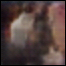

925 991
397 463


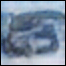

925 991
463 530


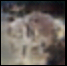

991 1058
0 66


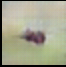

991 1058
66 132


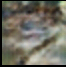

991 1058
132 198


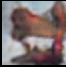

991 1058
198 265


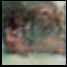

991 1058
265 331


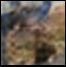

991 1058
331 397


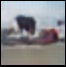

991 1058
397 463


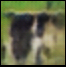

991 1058
463 530


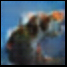

images/output/fake_samples_epoch_017.png
0 66
0 66


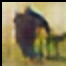

0 66
66 132


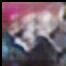

0 66
132 198


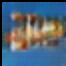

0 66
198 265


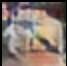

0 66
265 331


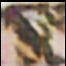

0 66
331 397


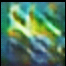

0 66
397 463


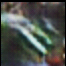

0 66
463 530


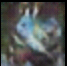

66 132
0 66


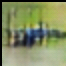

66 132
66 132


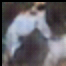

66 132
132 198


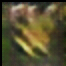

66 132
198 265


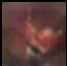

66 132
265 331


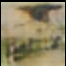

66 132
331 397


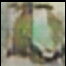

66 132
397 463


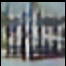

66 132
463 530


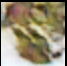

132 198
0 66


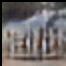

132 198
66 132


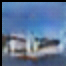

132 198
132 198


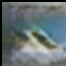

132 198
198 265


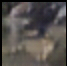

132 198
265 331


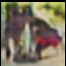

132 198
331 397


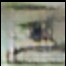

132 198
397 463


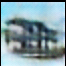

132 198
463 530


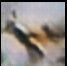

198 264
0 66


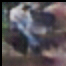

198 264
66 132


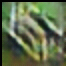

198 264
132 198


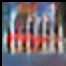

198 264
198 265


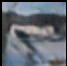

198 264
265 331


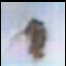

198 264
331 397


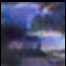

198 264
397 463


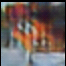

198 264
463 530


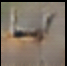

264 330
0 66


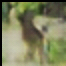

264 330
66 132


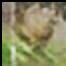

264 330
132 198


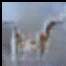

264 330
198 265


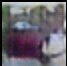

264 330
265 331


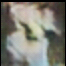

264 330
331 397


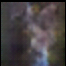

264 330
397 463


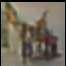

264 330
463 530


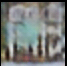

330 396
0 66


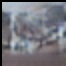

330 396
66 132


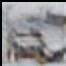

330 396
132 198


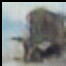

330 396
198 265


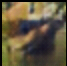

330 396
265 331


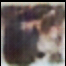

330 396
331 397


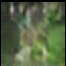

330 396
397 463


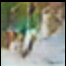

330 396
463 530


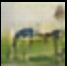

396 462
0 66


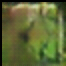

396 462
66 132


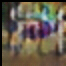

396 462
132 198


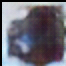

396 462
198 265


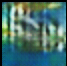

396 462
265 331


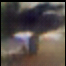

396 462
331 397


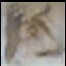

396 462
397 463


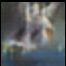

396 462
463 530


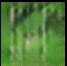

462 529
0 66


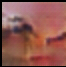

462 529
66 132


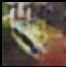

462 529
132 198


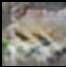

462 529
198 265


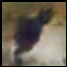

462 529
265 331


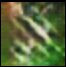

462 529
331 397


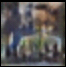

462 529
397 463


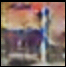

462 529
463 530


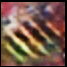

529 595
0 66


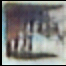

529 595
66 132


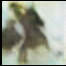

529 595
132 198


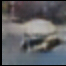

529 595
198 265


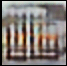

529 595
265 331


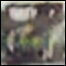

529 595
331 397


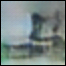

529 595
397 463


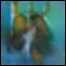

529 595
463 530


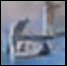

595 661
0 66


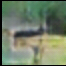

595 661
66 132


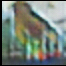

595 661
132 198


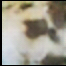

595 661
198 265


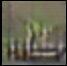

595 661
265 331


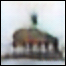

595 661
331 397


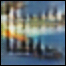

595 661
397 463


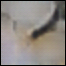

595 661
463 530


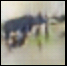

661 727
0 66


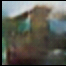

661 727
66 132


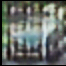

661 727
132 198


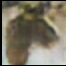

661 727
198 265


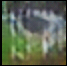

661 727
265 331


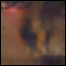

661 727
331 397


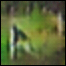

661 727
397 463


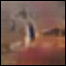

661 727
463 530


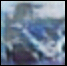

727 793
0 66


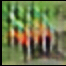

727 793
66 132


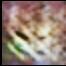

727 793
132 198


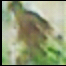

727 793
198 265


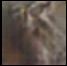

727 793
265 331


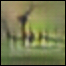

727 793
331 397


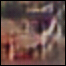

727 793
397 463


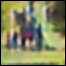

727 793
463 530


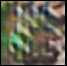

793 859
0 66


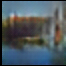

793 859
66 132


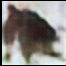

793 859
132 198


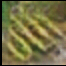

793 859
198 265


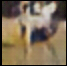

793 859
265 331


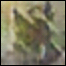

793 859
331 397


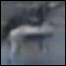

793 859
397 463


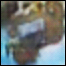

793 859
463 530


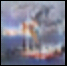

859 925
0 66


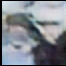

859 925
66 132


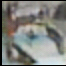

859 925
132 198


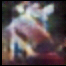

859 925
198 265


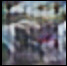

859 925
265 331


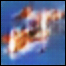

859 925
331 397


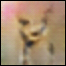

859 925
397 463


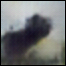

859 925
463 530


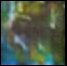

925 991
0 66


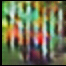

925 991
66 132


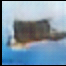

925 991
132 198


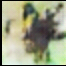

925 991
198 265


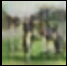

925 991
265 331


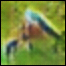

925 991
331 397


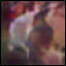

925 991
397 463


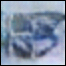

925 991
463 530


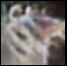

991 1058
0 66


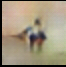

991 1058
66 132


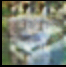

991 1058
132 198


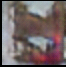

991 1058
198 265


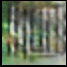

991 1058
265 331


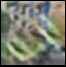

991 1058
331 397


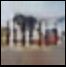

991 1058
397 463


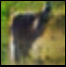

991 1058
463 530


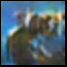

images/output/fake_samples_epoch_018.png
0 66
0 66


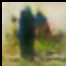

0 66
66 132


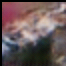

0 66
132 198


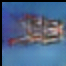

0 66
198 265


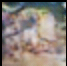

0 66
265 331


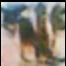

0 66
331 397


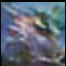

0 66
397 463


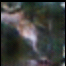

0 66
463 530


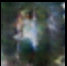

66 132
0 66


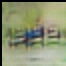

66 132
66 132


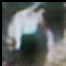

66 132
132 198


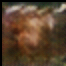

66 132
198 265


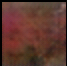

66 132
265 331


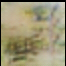

66 132
331 397


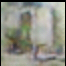

66 132
397 463


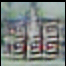

66 132
463 530


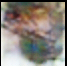

132 198
0 66


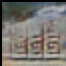

132 198
66 132


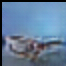

132 198
132 198


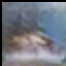

132 198
198 265


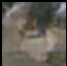

132 198
265 331


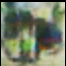

132 198
331 397


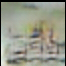

132 198
397 463


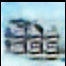

132 198
463 530


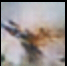

198 264
0 66


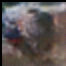

198 264
66 132


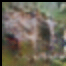

198 264
132 198


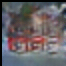

198 264
198 265


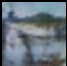

198 264
265 331


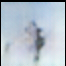

198 264
331 397


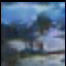

198 264
397 463


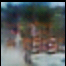

198 264
463 530


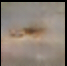

264 330
0 66


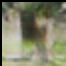

264 330
66 132


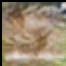

264 330
132 198


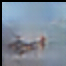

264 330
198 265


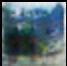

264 330
265 331


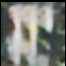

264 330
331 397


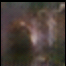

264 330
397 463


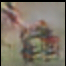

264 330
463 530


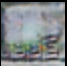

330 396
0 66


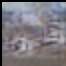

330 396
66 132


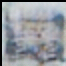

330 396
132 198


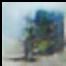

330 396
198 265


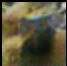

330 396
265 331


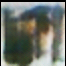

330 396
331 397


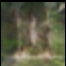

330 396
397 463


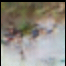

330 396
463 530


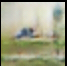

396 462
0 66


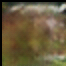

396 462
66 132


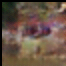

396 462
132 198


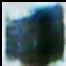

396 462
198 265


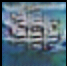

396 462
265 331


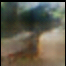

396 462
331 397


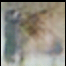

396 462
397 463


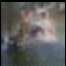

396 462
463 530


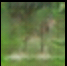

462 529
0 66


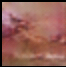

462 529
66 132


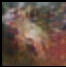

462 529
132 198


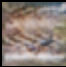

462 529
198 265


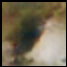

462 529
265 331


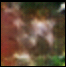

462 529
331 397


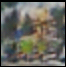

462 529
397 463


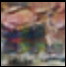

462 529
463 530


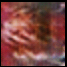

529 595
0 66


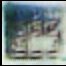

529 595
66 132


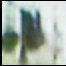

529 595
132 198


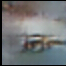

529 595
198 265


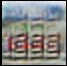

529 595
265 331


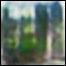

529 595
331 397


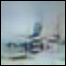

529 595
397 463


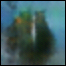

529 595
463 530


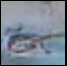

595 661
0 66


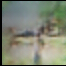

595 661
66 132


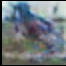

595 661
132 198


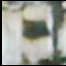

595 661
198 265


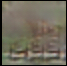

595 661
265 331


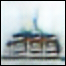

595 661
331 397


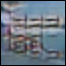

595 661
397 463


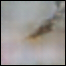

595 661
463 530


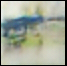

661 727
0 66


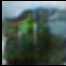

661 727
66 132


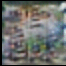

661 727
132 198


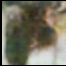

661 727
198 265


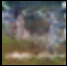

661 727
265 331


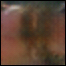

661 727
331 397


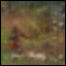

661 727
397 463


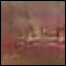

661 727
463 530


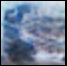

727 793
0 66


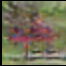

727 793
66 132


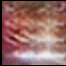

727 793
132 198


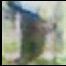

727 793
198 265


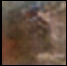

727 793
265 331


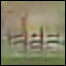

727 793
331 397


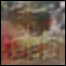

727 793
397 463


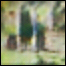

727 793
463 530


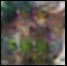

793 859
0 66


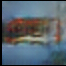

793 859
66 132


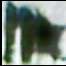

793 859
132 198


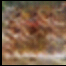

793 859
198 265


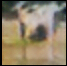

793 859
265 331


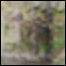

793 859
331 397


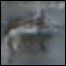

793 859
397 463


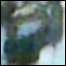

793 859
463 530


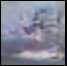

859 925
0 66


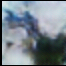

859 925
66 132


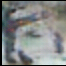

859 925
132 198


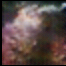

859 925
198 265


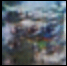

859 925
265 331


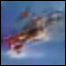

859 925
331 397


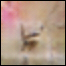

859 925
397 463


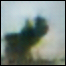

859 925
463 530


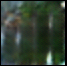

925 991
0 66


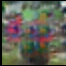

925 991
66 132


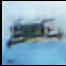

925 991
132 198


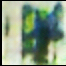

925 991
198 265


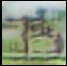

925 991
265 331


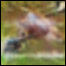

925 991
331 397


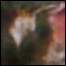

925 991
397 463


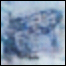

925 991
463 530


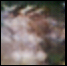

991 1058
0 66


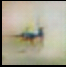

991 1058
66 132


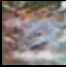

991 1058
132 198


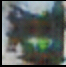

991 1058
198 265


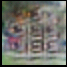

991 1058
265 331


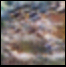

991 1058
331 397


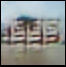

991 1058
397 463


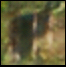

991 1058
463 530


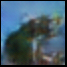

images/output/fake_samples_epoch_019.png
0 66
0 66


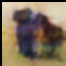

0 66
66 132


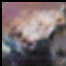

0 66
132 198


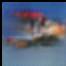

0 66
198 265


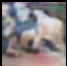

0 66
265 331


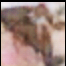

0 66
331 397


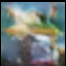

0 66
397 463


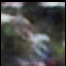

0 66
463 530


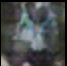

66 132
0 66


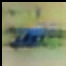

66 132
66 132


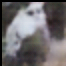

66 132
132 198


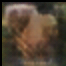

66 132
198 265


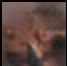

66 132
265 331


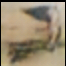

66 132
331 397


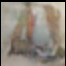

66 132
397 463


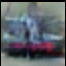

66 132
463 530


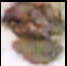

132 198
0 66


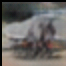

132 198
66 132


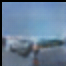

132 198
132 198


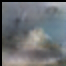

132 198
198 265


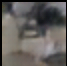

132 198
265 331


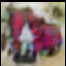

132 198
331 397


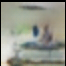

132 198
397 463


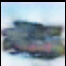

132 198
463 530


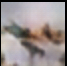

198 264
0 66


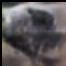

198 264
66 132


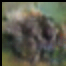

198 264
132 198


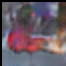

198 264
198 265


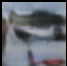

198 264
265 331


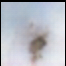

198 264
331 397


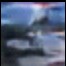

198 264
397 463


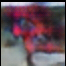

198 264
463 530


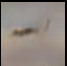

264 330
0 66


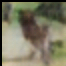

264 330
66 132


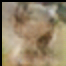

264 330
132 198


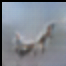

264 330
198 265


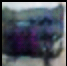

264 330
265 331


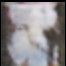

264 330
331 397


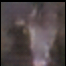

264 330
397 463


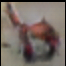

264 330
463 530


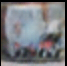

330 396
0 66


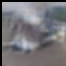

330 396
66 132


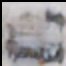

330 396
132 198


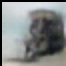

330 396
198 265


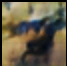

330 396
265 331


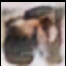

330 396
331 397


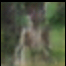

330 396
397 463


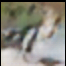

330 396
463 530


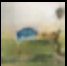

396 462
0 66


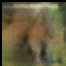

396 462
66 132


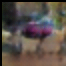

396 462
132 198


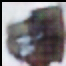

396 462
198 265


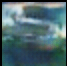

396 462
265 331


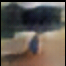

396 462
331 397


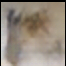

396 462
397 463


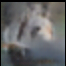

396 462
463 530


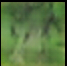

462 529
0 66


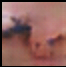

462 529
66 132


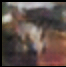

462 529
132 198


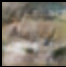

462 529
198 265


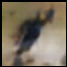

462 529
265 331


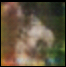

462 529
331 397


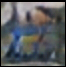

462 529
397 463


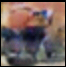

462 529
463 530


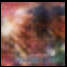

529 595
0 66


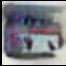

529 595
66 132


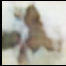

529 595
132 198


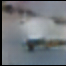

529 595
198 265


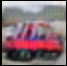

529 595
265 331


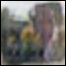

529 595
331 397


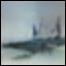

529 595
397 463


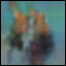

529 595
463 530


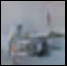

595 661
0 66


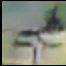

595 661
66 132


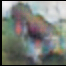

595 661
132 198


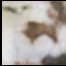

595 661
198 265


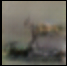

595 661
265 331


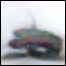

595 661
331 397


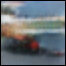

595 661
397 463


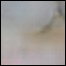

595 661
463 530


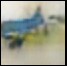

661 727
0 66


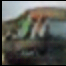

661 727
66 132


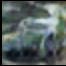

661 727
132 198


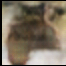

661 727
198 265


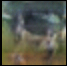

661 727
265 331


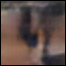

661 727
331 397


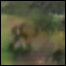

661 727
397 463


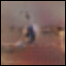

661 727
463 530


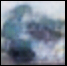

727 793
0 66


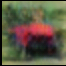

727 793
66 132


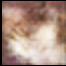

727 793
132 198


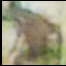

727 793
198 265


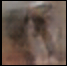

727 793
265 331


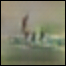

727 793
331 397


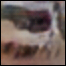

727 793
397 463


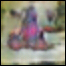

727 793
463 530


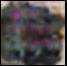

793 859
0 66


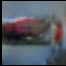

793 859
66 132


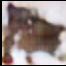

793 859
132 198


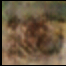

793 859
198 265


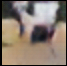

793 859
265 331


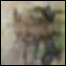

793 859
331 397


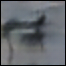

793 859
397 463


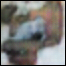

793 859
463 530


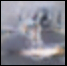

859 925
0 66


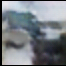

859 925
66 132


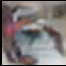

859 925
132 198


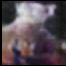

859 925
198 265


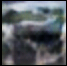

859 925
265 331


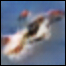

859 925
331 397


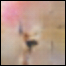

859 925
397 463


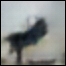

859 925
463 530


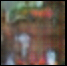

925 991
0 66


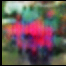

925 991
66 132


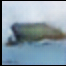

925 991
132 198


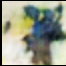

925 991
198 265


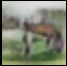

925 991
265 331


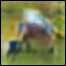

925 991
331 397


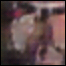

925 991
397 463


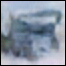

925 991
463 530


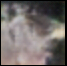

991 1058
0 66


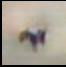

991 1058
66 132


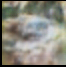

991 1058
132 198


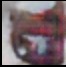

991 1058
198 265


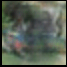

991 1058
265 331


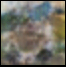

991 1058
331 397


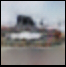

991 1058
397 463


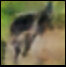

991 1058
463 530


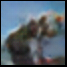

images/output/fake_samples_epoch_020.png
0 66
0 66


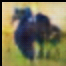

0 66
66 132


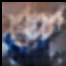

0 66
132 198


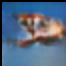

0 66
198 265


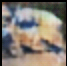

0 66
265 331


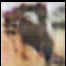

0 66
331 397


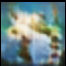

0 66
397 463


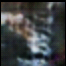

0 66
463 530


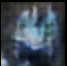

66 132
0 66


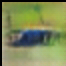

66 132
66 132


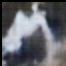

66 132
132 198


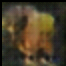

66 132
198 265


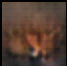

66 132
265 331


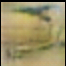

66 132
331 397


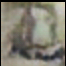

66 132
397 463


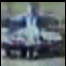

66 132
463 530


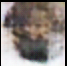

132 198
0 66


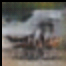

132 198
66 132


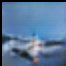

132 198
132 198


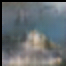

132 198
198 265


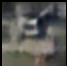

132 198
265 331


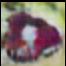

132 198
331 397


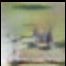

132 198
397 463


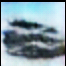

132 198
463 530


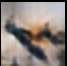

198 264
0 66


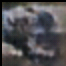

198 264
66 132


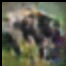

198 264
132 198


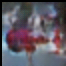

198 264
198 265


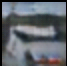

198 264
265 331


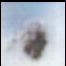

198 264
331 397


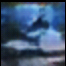

198 264
397 463


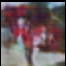

198 264
463 530


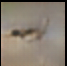

264 330
0 66


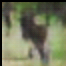

264 330
66 132


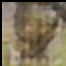

264 330
132 198


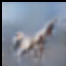

264 330
198 265


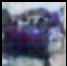

264 330
265 331


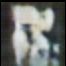

264 330
331 397


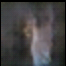

264 330
397 463


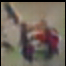

264 330
463 530


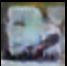

330 396
0 66


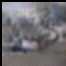

330 396
66 132


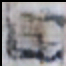

330 396
132 198


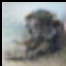

330 396
198 265


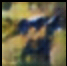

330 396
265 331


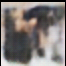

330 396
331 397


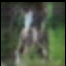

330 396
397 463


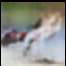

330 396
463 530


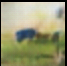

396 462
0 66


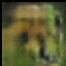

396 462
66 132


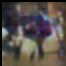

396 462
132 198


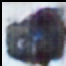

396 462
198 265


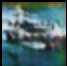

396 462
265 331


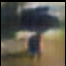

396 462
331 397


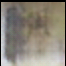

396 462
397 463


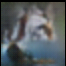

396 462
463 530


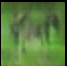

462 529
0 66


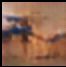

462 529
66 132


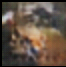

462 529
132 198


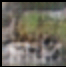

462 529
198 265


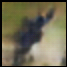

462 529
265 331


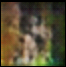

462 529
331 397


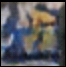

462 529
397 463


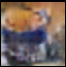

462 529
463 530


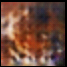

529 595
0 66


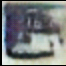

529 595
66 132


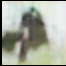

529 595
132 198


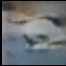

529 595
198 265


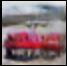

529 595
265 331


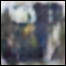

529 595
331 397


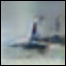

529 595
397 463


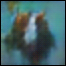

529 595
463 530


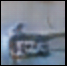

595 661
0 66


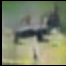

595 661
66 132


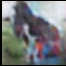

595 661
132 198


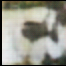

595 661
198 265


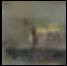

595 661
265 331


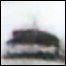

595 661
331 397


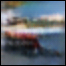

595 661
397 463


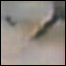

595 661
463 530


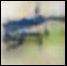

661 727
0 66


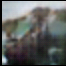

661 727
66 132


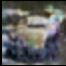

661 727
132 198


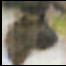

661 727
198 265


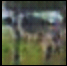

661 727
265 331


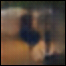

661 727
331 397


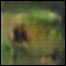

661 727
397 463


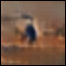

661 727
463 530


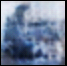

727 793
0 66


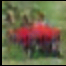

727 793
66 132


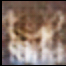

727 793
132 198


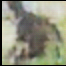

727 793
198 265


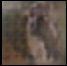

727 793
265 331


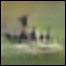

727 793
331 397


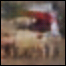

727 793
397 463


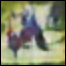

727 793
463 530


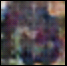

793 859
0 66


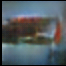

793 859
66 132


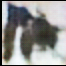

793 859
132 198


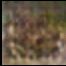

793 859
198 265


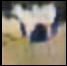

793 859
265 331


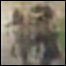

793 859
331 397


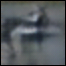

793 859
397 463


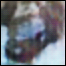

793 859
463 530


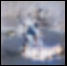

859 925
0 66


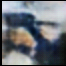

859 925
66 132


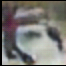

859 925
132 198


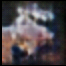

859 925
198 265


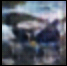

859 925
265 331


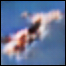

859 925
331 397


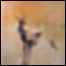

859 925
397 463


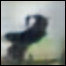

859 925
463 530


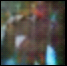

925 991
0 66


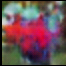

925 991
66 132


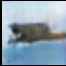

925 991
132 198


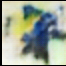

925 991
198 265


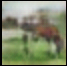

925 991
265 331


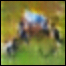

925 991
331 397


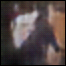

925 991
397 463


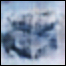

925 991
463 530


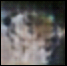

991 1058
0 66


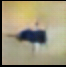

991 1058
66 132


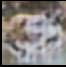

991 1058
132 198


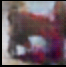

991 1058
198 265


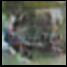

991 1058
265 331


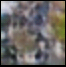

991 1058
331 397


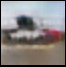

991 1058
397 463


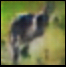

991 1058
463 530


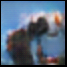

images/output/fake_samples_epoch_021.png
0 66
0 66


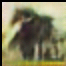

0 66
66 132


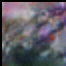

0 66
132 198


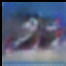

0 66
198 265


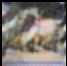

0 66
265 331


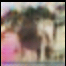

0 66
331 397


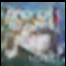

0 66
397 463


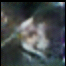

0 66
463 530


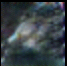

66 132
0 66


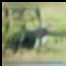

66 132
66 132


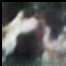

66 132
132 198


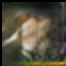

66 132
198 265


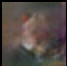

66 132
265 331


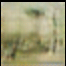

66 132
331 397


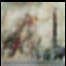

66 132
397 463


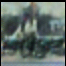

66 132
463 530


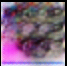

132 198
0 66


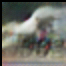

132 198
66 132


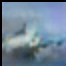

132 198
132 198


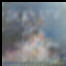

132 198
198 265


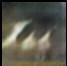

132 198
265 331


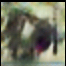

132 198
331 397


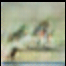

132 198
397 463


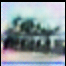

132 198
463 530


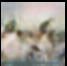

198 264
0 66


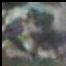

198 264
66 132


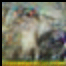

198 264
132 198


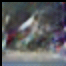

198 264
198 265


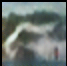

198 264
265 331


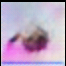

198 264
331 397


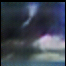

198 264
397 463


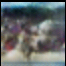

198 264
463 530


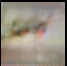

264 330
0 66


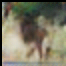

264 330
66 132


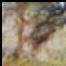

264 330
132 198


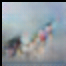

264 330
198 265


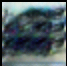

264 330
265 331


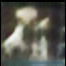

264 330
331 397


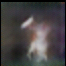

264 330
397 463


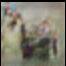

264 330
463 530


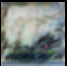

330 396
0 66


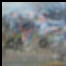

330 396
66 132


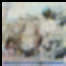

330 396
132 198


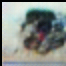

330 396
198 265


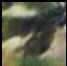

330 396
265 331


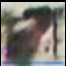

330 396
331 397


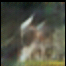

330 396
397 463


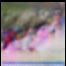

330 396
463 530


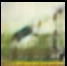

396 462
0 66


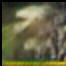

396 462
66 132


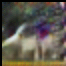

396 462
132 198


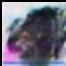

396 462
198 265


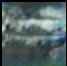

396 462
265 331


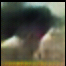

396 462
331 397


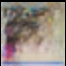

396 462
397 463


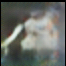

396 462
463 530


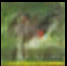

462 529
0 66


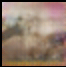

462 529
66 132


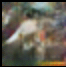

462 529
132 198


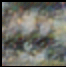

462 529
198 265


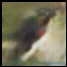

462 529
265 331


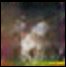

462 529
331 397


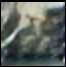

462 529
397 463


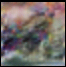

462 529
463 530


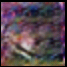

529 595
0 66


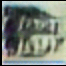

529 595
66 132


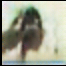

529 595
132 198


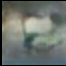

529 595
198 265


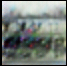

529 595
265 331


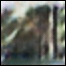

529 595
331 397


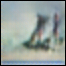

529 595
397 463


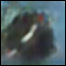

529 595
463 530


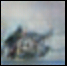

595 661
0 66


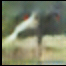

595 661
66 132


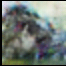

595 661
132 198


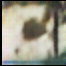

595 661
198 265


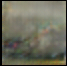

595 661
265 331


595 661
331 397


595 661
397 463


595 661
463 530


661 727
0 66


661 727
66 132


661 727
132 198


661 727
198 265


661 727
265 331


661 727
331 397


661 727
397 463


661 727
463 530


727 793
0 66


727 793
66 132


727 793
132 198


727 793
198 265


727 793
265 331


727 793
331 397


727 793
397 463


727 793
463 530


793 859
0 66


793 859
66 132


793 859
132 198


793 859
198 265


793 859
265 331


793 859
331 397


793 859
397 463


793 859
463 530


859 925
0 66


859 925
66 132


859 925
132 198


859 925
198 265


859 925
265 331


859 925
331 397


859 925
397 463


859 925
463 530


925 991
0 66


925 991
66 132


925 991
132 198


925 991
198 265


925 991
265 331


925 991
331 397


925 991
397 463


925 991
463 530


991 1058
0 66


991 1058
66 132


991 1058
132 198


991 1058
198 265


991 1058
265 331


991 1058
331 397


991 1058
397 463


991 1058
463 530


images/output/fake_samples_epoch_022.png
0 66
0 66


0 66
66 132


0 66
132 198


0 66
198 265


0 66
265 331


0 66
331 397


0 66
397 463


0 66
463 530


66 132
0 66


66 132
66 132


66 132
132 198


66 132
198 265


66 132
265 331


66 132
331 397


66 132
397 463


66 132
463 530


132 198
0 66


132 198
66 132


132 198
132 198


132 198
198 265


132 198
265 331


132 198
331 397


132 198
397 463


132 198
463 530


198 264
0 66


198 264
66 132


198 264
132 198


198 264
198 265


198 264
265 331


198 264
331 397


198 264
397 463


198 264
463 530


264 330
0 66


264 330
66 132


264 330
132 198


264 330
198 265


264 330
265 331


264 330
331 397


264 330
397 463


264 330
463 530


330 396
0 66


330 396
66 132


330 396
132 198


330 396
198 265


330 396
265 331


330 396
331 397


330 396
397 463


330 396
463 530


396 462
0 66


396 462
66 132


396 462
132 198


396 462
198 265


396 462
265 331


396 462
331 397


396 462
397 463


396 462
463 530


462 529
0 66


462 529
66 132


462 529
132 198


462 529
198 265


462 529
265 331


462 529
331 397


462 529
397 463


462 529
463 530


529 595
0 66


529 595
66 132


529 595
132 198


529 595
198 265


529 595
265 331


529 595
331 397


529 595
397 463


529 595
463 530


595 661
0 66


595 661
66 132


595 661
132 198


595 661
198 265


595 661
265 331


595 661
331 397


595 661
397 463


595 661
463 530


661 727
0 66


661 727
66 132


661 727
132 198


661 727
198 265


661 727
265 331


661 727
331 397


661 727
397 463


661 727
463 530


727 793
0 66


727 793
66 132


727 793
132 198


727 793
198 265


727 793
265 331


727 793
331 397


727 793
397 463


727 793
463 530


793 859
0 66


793 859
66 132


793 859
132 198


793 859
198 265


793 859
265 331


793 859
331 397


793 859
397 463


793 859
463 530


859 925
0 66


859 925
66 132


859 925
132 198


859 925
198 265


859 925
265 331


859 925
331 397


859 925
397 463


859 925
463 530


925 991
0 66


925 991
66 132


925 991
132 198


925 991
198 265


925 991
265 331


925 991
331 397


925 991
397 463


925 991
463 530


991 1058
0 66


991 1058
66 132


991 1058
132 198


991 1058
198 265


991 1058
265 331


991 1058
331 397


991 1058
397 463


991 1058
463 530


images/output/fake_samples_epoch_023.png
0 66
0 66


0 66
66 132


0 66
132 198


0 66
198 265


0 66
265 331


0 66
331 397


0 66
397 463


0 66
463 530


66 132
0 66


66 132
66 132


66 132
132 198


66 132
198 265


66 132
265 331


66 132
331 397


66 132
397 463


66 132
463 530


132 198
0 66


132 198
66 132


132 198
132 198


132 198
198 265


132 198
265 331


132 198
331 397


132 198
397 463


132 198
463 530


198 264
0 66


198 264
66 132


198 264
132 198


198 264
198 265


198 264
265 331


198 264
331 397


198 264
397 463


198 264
463 530


264 330
0 66


264 330
66 132


264 330
132 198


264 330
198 265


264 330
265 331


264 330
331 397


264 330
397 463


264 330
463 530


330 396
0 66


330 396
66 132


330 396
132 198


330 396
198 265


330 396
265 331


330 396
331 397


330 396
397 463


330 396
463 530


396 462
0 66


396 462
66 132


396 462
132 198


396 462
198 265


396 462
265 331


396 462
331 397


396 462
397 463


396 462
463 530


462 529
0 66


462 529
66 132


462 529
132 198


462 529
198 265


462 529
265 331


462 529
331 397


462 529
397 463


462 529
463 530


529 595
0 66


529 595
66 132


529 595
132 198


529 595
198 265


529 595
265 331


529 595
331 397


529 595
397 463


529 595
463 530


595 661
0 66


595 661
66 132


595 661
132 198


595 661
198 265


595 661
265 331


595 661
331 397


595 661
397 463


595 661
463 530


661 727
0 66


661 727
66 132


661 727
132 198


661 727
198 265


661 727
265 331


661 727
331 397


661 727
397 463


661 727
463 530


727 793
0 66


727 793
66 132


727 793
132 198


727 793
198 265


727 793
265 331


727 793
331 397


727 793
397 463


727 793
463 530


793 859
0 66


793 859
66 132


793 859
132 198


793 859
198 265


793 859
265 331


793 859
331 397


793 859
397 463


793 859
463 530


859 925
0 66


859 925
66 132


859 925
132 198


859 925
198 265


859 925
265 331


859 925
331 397


859 925
397 463


859 925
463 530


925 991
0 66


925 991
66 132


925 991
132 198


925 991
198 265


925 991
265 331


925 991
331 397


925 991
397 463


925 991
463 530


991 1058
0 66


991 1058
66 132


991 1058
132 198


991 1058
198 265


991 1058
265 331


991 1058
331 397


991 1058
397 463


991 1058
463 530


images/output/fake_samples_epoch_024.png
0 66
0 66


0 66
66 132


0 66
132 198


0 66
198 265


0 66
265 331


0 66
331 397


0 66
397 463


0 66
463 530


66 132
0 66


66 132
66 132


66 132
132 198


66 132
198 265


66 132
265 331


66 132
331 397


66 132
397 463


66 132
463 530


132 198
0 66


132 198
66 132


132 198
132 198


132 198
198 265


132 198
265 331


132 198
331 397


132 198
397 463


132 198
463 530


198 264
0 66


198 264
66 132


198 264
132 198


198 264
198 265


198 264
265 331


198 264
331 397


198 264
397 463


198 264
463 530


264 330
0 66


264 330
66 132


264 330
132 198


264 330
198 265


264 330
265 331


264 330
331 397


264 330
397 463


264 330
463 530


330 396
0 66


330 396
66 132


330 396
132 198


330 396
198 265


330 396
265 331


330 396
331 397


330 396
397 463


330 396
463 530


396 462
0 66


396 462
66 132


396 462
132 198


396 462
198 265


396 462
265 331


396 462
331 397


396 462
397 463


396 462
463 530


462 529
0 66


462 529
66 132


462 529
132 198


462 529
198 265


462 529
265 331


462 529
331 397


462 529
397 463


462 529
463 530


529 595
0 66


529 595
66 132


529 595
132 198


529 595
198 265


529 595
265 331


529 595
331 397


529 595
397 463


529 595
463 530


595 661
0 66


595 661
66 132


595 661
132 198


595 661
198 265


595 661
265 331


595 661
331 397


595 661
397 463


595 661
463 530


661 727
0 66


661 727
66 132


661 727
132 198


661 727
198 265


661 727
265 331


661 727
331 397


661 727
397 463


661 727
463 530


727 793
0 66


727 793
66 132


727 793
132 198


727 793
198 265


727 793
265 331


727 793
331 397


727 793
397 463


727 793
463 530


793 859
0 66


793 859
66 132


793 859
132 198


793 859
198 265


793 859
265 331


793 859
331 397


793 859
397 463


793 859
463 530


859 925
0 66


859 925
66 132


859 925
132 198


859 925
198 265


859 925
265 331


859 925
331 397


859 925
397 463


859 925
463 530


925 991
0 66


925 991
66 132


925 991
132 198


925 991
198 265


925 991
265 331


925 991
331 397


925 991
397 463


925 991
463 530


991 1058
0 66


991 1058
66 132


991 1058
132 198


991 1058
198 265


991 1058
265 331


991 1058
331 397


991 1058
397 463


991 1058
463 530


In [ ]:
for epoch in range(6,25):
  input_path = 'images/output/fake_samples_epoch_0'
  filename = 'image_data/output_'
  if(epoch<10):
    string_epoch = '0' + str(epoch)
    input_path = input_path + string_epoch + '.png'
  else:
    input_path = input_path + str(epoch) + '.png'
  image = cv2.imread(input_path)
  print(input_path)
  height, width = image.shape[:2]
  filename = filename+str(epoch)
  subimages(image,height,width,filename)


In [ ]:
!zip -r gan-data.zip image_data/

updating: image_data/ (stored 0%)
updating: image_data/image_data/ (stored 0%)
updating: image_data/image_data/output_223300.png (stored 0%)
updating: image_data/image_data/output_1833066.png (stored 0%)
updating: image_data/image_data/output_249250.png (stored 0%)
updating: image_data/image_data/output_143960.png (stored 0%)
updating: image_data/image_data/output_22264198.png (stored 0%)
updating: image_data/image_data/output_2266463.png (deflated 0%)
updating: image_data/image_data/output_167270.png (stored 0%)
updating: image_data/image_data/output_15264265.png (stored 0%)
updating: image_data/image_data/output_186666.png (stored 0%)
updating: image_data/image_data/output_18264463.png (stored 0%)
updating: image_data/image_data/output_13462331.png (stored 0%)
updating: image_data/image_data/output_24991265.png (stored 0%)
updating: image_data/image_data/output_746266.png (stored 0%)
updating: image_data/image_data/output_10198132.png (stored 0%)
updating: image_data/image_data/outpu

In [28]:
!unzip "gan-data.zip" -d "image_data"

Archive:  gan-data.zip
   creating: image_data/image_data/
 extracting: image_data/image_data/output_6132265.png  
 extracting: image_data/image_data/output_15462463.png  
 extracting: image_data/image_data/output_10132397.png  
 extracting: image_data/image_data/output_21198463.png  
 extracting: image_data/image_data/output_20462132.png  
 extracting: image_data/image_data/output_2413266.png  
 extracting: image_data/image_data/output_22727265.png  
 extracting: image_data/image_data/output_150265.png  
 extracting: image_data/image_data/output_21264397.png  
  inflating: image_data/image_data/output_8727463.png  
 extracting: image_data/image_data/output_213300.png  
 extracting: image_data/image_data/output_9925265.png  
 extracting: image_data/image_data/output_966397.png  
 extracting: image_data/image_data/output_2400.png  
 extracting: image_data/image_data/output_979366.png  
 extracting: image_data/image_data/output_9198463.png  
 extracting: image_data/image_data/output_1319

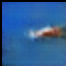

In [29]:
imag_fake = cv2.imread('image_data/image_data/output_100132.png')
cv2_imshow(imag_fake)

In [ ]:
from google.colab import files
files.download('gan-data.zip') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

##Loading pretrained model and generating labels for the GAN images

In [30]:
!unzip "PyTorch_CIFAR10.zip" -d "pretrained"

Archive:  PyTorch_CIFAR10.zip
   creating: pretrained/PyTorch_CIFAR10/.git/
  inflating: pretrained/PyTorch_CIFAR10/.git/config  
  inflating: pretrained/PyTorch_CIFAR10/.git/description  
 extracting: pretrained/PyTorch_CIFAR10/.git/HEAD  
   creating: pretrained/PyTorch_CIFAR10/.git/hooks/
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/applypatch-msg.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/commit-msg.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/fsmonitor-watchman.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/post-update.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/pre-applypatch.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/pre-commit.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/pre-merge-commit.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/prepare-commit-msg.sample  
  inflating: pretrained/PyTorch_CIFAR10/.git/hooks/pre-push.sample  
  inflating: pretrained/PyTorch_CIFAR10

In [31]:
cd pretrained/PyTorch_CIFAR10/

/content/pretrained/PyTorch_CIFAR10


In [32]:
! python cifar10_download.py

100% 2.46G/2.46G [02:28<00:00, 16.6MMiB/s]
Download successful. Unzipping file.
Unzip file successful!


In [33]:
from cifar10_models import *

Tested out multiple pretrained models and chose the one which worked best

In [ ]:
model = densenet161(pretrained=True)

In [34]:
model_second = vgg11_bn(pretrained=True).to(device)

In [ ]:
model_third = resnet50(pretrained=True)

In [ ]:
vgg_model = torchvision.models.vgg16('cifar10vgg.h5').to(device)

In [35]:
cd ../..

/content


###Cifar 10 pretrained model testing

In [36]:
def NNevaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model_second(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [ ]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

for epoch in range(max_epochs):

    for i, data in enumerate(trainloader, 0):

        inputs, labels = data
        #print(inputs.shape)
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = model_second(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, NNevaluation(testloader), NNevaluation(trainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 90.88, Train acc: 99.50
Epoch: 10/60, Test acc: 90.90, Train acc: 99.47
Epoch: 20/60, Test acc: 90.90, Train acc: 99.49
Epoch: 30/60, Test acc: 90.85, Train acc: 99.52
Epoch: 40/60, Test acc: 90.88, Train acc: 99.49
Epoch: 50/60, Test acc: 90.95, Train acc: 99.52
Epoch: 59/60, Test acc: 90.99, Train acc: 99.50


###Working with the pretrained model on GAN images

In [37]:
DATA_PATH = "image_data/image_data"
#transform = transforms.Resize(32)
img_inp = np.zeros((2432,3,32,32))
i = 0
for img in os.listdir(DATA_PATH):  
  img_array = cv2.imread(os.path.join(DATA_PATH,img))   # convert to array
  #print(img_array.shape)
  resized = cv2.resize(img_array, (32,32), interpolation = cv2.INTER_AREA)
  #print(resized.shape)
  resized = np.transpose(resized,(2,1,0))
  #print(resized.shape)
  #plt.imshow(resized, cmap='gray')  # graph it
  #plt.show()  # display!
  img_inp[i] = resized
  i+=1


sliced_arr = img_inp[2200:2232]

arr_tensor = torch.from_numpy(sliced_arr).to(device)
#print(arr_tensor.shape)
#print(arr_tensor[0].shape)
#print(arr_tensor[0])



pred = model_second(arr_tensor.float())
_, res = torch.max(pred,1)
print(res)


tensor([9, 5, 2, 2, 7, 1, 8, 5, 6, 4, 3, 6, 4, 0, 9, 1, 5, 7, 4, 3, 0, 8, 3, 0,
        0, 0, 2, 3, 3, 2, 1, 1], device='cuda:0')


##Data Augmentation with DCGAN Images

In [38]:
def GANevaluation(dataloader,GANcorrect,GANtotal):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = net(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * (correct + GANcorrect) / (total + GANtotal)

Augmentation is carried out by adding 32 different images from the GAN dataset in every epoch

In [41]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

DATA_PATH = "image_data/image_data"
img_inp = np.zeros((2432,3,32,32))

gan_batch_size = 40
i = 0 #starting index of img_inp array

for img in os.listdir(DATA_PATH):  
  img_array = cv2.imread(os.path.join(DATA_PATH,img))
  resized = cv2.resize(img_array, (32,32), interpolation = cv2.INTER_AREA)
  resized = np.transpose(resized,(2,1,0))
  img_inp[i] = resized
  i+=1

for epoch in range(max_epochs):

    for i, data in enumerate(trainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = net(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    #training on 40 DCGAN images

    sliced_arr = img_inp[i: i + gan_batch_size - 1]
    arr_tensor = torch.from_numpy(sliced_arr).to(device)

    correct = model_second(arr_tensor.float())
    _, label = torch.max(correct,1)

    output = net(arr_tensor.float())
    _, pred = torch.max(output,1)
    
    
    label = label.long()

    opt.zero_grad()

    loss += loss_fn(output,label)

    loss_epoch_arr.append(loss.item())

    
    opt.step()

    loss_epoch_arr.append(loss.item())

    GANcorrect = (pred == label).sum().item()

    GANtotal = gan_batch_size
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, GANevaluation(testloader,0,0), GANevaluation(trainloader,GANcorrect,GANtotal)))

    i += gan_batch_size

  
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 59.30, Train acc: 63.28
Epoch: 10/60, Test acc: 59.42, Train acc: 63.37
Epoch: 20/60, Test acc: 59.77, Train acc: 62.90
Epoch: 30/60, Test acc: 59.19, Train acc: 62.88
Epoch: 40/60, Test acc: 60.06, Train acc: 64.00
Epoch: 50/60, Test acc: 60.34, Train acc: 63.72
Epoch: 59/60, Test acc: 59.31, Train acc: 62.60


#Other Augmentation techniques

##Random Horizontal Flip

In [42]:
transform_train = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

In [43]:
batch_size = 128
RHFtrainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform_train)
RHFtrainloader = torch.utils.data.DataLoader(RHFtrainset, batch_size=batch_size, shuffle=True)
RHFtestset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform_test)
RHFtestloader = torch.utils.data.DataLoader(RHFtestset, batch_size=batch_size, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


In [44]:
rhfNet = LeNet().to(device)

In [45]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(rhfNet.parameters(),weight_decay=4e-3)

In [46]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = rhfNet(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [47]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

for epoch in range(max_epochs):

    for i, data in enumerate(RHFtrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = rhfNet(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(RHFtestloader), evaluation(RHFtrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 41.42, Train acc: 41.21
Epoch: 10/60, Test acc: 55.95, Train acc: 56.92
Epoch: 20/60, Test acc: 57.42, Train acc: 59.01
Epoch: 30/60, Test acc: 58.74, Train acc: 61.14
Epoch: 40/60, Test acc: 60.92, Train acc: 62.44
Epoch: 50/60, Test acc: 61.87, Train acc: 63.89
Epoch: 59/60, Test acc: 60.67, Train acc: 63.05


##Random Rotation

In [48]:
transform_train = transforms.Compose([
    transforms.RandomRotation(90),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

In [49]:
batch_size = 128
RRtrainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform_train)
RRtrainloader = torch.utils.data.DataLoader(RRtrainset, batch_size=batch_size, shuffle=True)
RRtestset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform_test)
RRtestloader = torch.utils.data.DataLoader(RRtestset, batch_size=batch_size, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


In [50]:
rrNet = LeNet().to(device)

In [51]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = rrNet(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [52]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(rrNet.parameters(),weight_decay=4e-3)

In [53]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

for epoch in range(max_epochs):

    for i, data in enumerate(RRtrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = rrNet(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(RRtestloader), evaluation(RRtrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 37.54, Train acc: 36.17
Epoch: 10/60, Test acc: 46.71, Train acc: 45.80
Epoch: 20/60, Test acc: 47.23, Train acc: 46.69
Epoch: 30/60, Test acc: 47.76, Train acc: 47.16
Epoch: 40/60, Test acc: 49.32, Train acc: 48.46
Epoch: 50/60, Test acc: 47.72, Train acc: 47.37
Epoch: 59/60, Test acc: 49.46, Train acc: 49.15


##Color Jitter

In [54]:
transform_train = transforms.Compose([
    transforms.ColorJitter(),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

In [55]:
batch_size = 128
CJtrainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform_train)
CJtrainloader = torch.utils.data.DataLoader(CJtrainset, batch_size=batch_size, shuffle=True)
CJtestset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform_test)
CJtestloader = torch.utils.data.DataLoader(CJtestset, batch_size=batch_size, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


In [56]:
cjNet = LeNet().to(device)

In [57]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = cjNet(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [58]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(cjNet.parameters(),weight_decay=4e-3)

In [59]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

for epoch in range(max_epochs):

    for i, data in enumerate(CJtrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = cjNet(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(CJtestloader), evaluation(CJtrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 41.48, Train acc: 41.73
Epoch: 10/60, Test acc: 55.62, Train acc: 59.05
Epoch: 20/60, Test acc: 57.48, Train acc: 60.63
Epoch: 30/60, Test acc: 58.68, Train acc: 62.90
Epoch: 40/60, Test acc: 59.58, Train acc: 64.37
Epoch: 50/60, Test acc: 60.81, Train acc: 65.63
Epoch: 59/60, Test acc: 61.06, Train acc: 65.25


##Multiple Augmentations

In [60]:
transform_train = transforms.Compose([
    transforms.ColorJitter(),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(90),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

In [61]:
batch_size = 128
Alltrainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform_train)
Alltrainloader = torch.utils.data.DataLoader(Alltrainset, batch_size=batch_size, shuffle=True)
Alltestset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform_test)
Alltestloader = torch.utils.data.DataLoader(Alltestset, batch_size=batch_size, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


In [62]:
allNet = LeNet().to(device)

In [63]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = allNet(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [64]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(allNet.parameters(),weight_decay=4e-3)

In [78]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

for epoch in range(max_epochs):

    for i, data in enumerate(Alltrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = allNet(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs -1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(Alltestloader), evaluation(Alltrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 50.29, Train acc: 49.72
Epoch: 10/60, Test acc: 50.29, Train acc: 49.75
Epoch: 20/60, Test acc: 50.29, Train acc: 49.71
Epoch: 30/60, Test acc: 50.29, Train acc: 49.82
Epoch: 40/60, Test acc: 50.29, Train acc: 49.87
Epoch: 50/60, Test acc: 50.29, Train acc: 49.87
Epoch: 59/60, Test acc: 50.29, Train acc: 49.87


###Multiple Augmentation with dcgan images

In [68]:
transform_train = transforms.Compose([
    transforms.ColorJitter(),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(90),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

In [69]:
batch_size = 128
Finaltrainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform_train)
Finaltrainloader = torch.utils.data.DataLoader(Finaltrainset, batch_size=batch_size, shuffle=True)
Finaltestset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform_test)
Finaltestloader = torch.utils.data.DataLoader(Finaltestset, batch_size=batch_size, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


In [73]:
FinalNet = LeNet().to(device)

In [74]:
def Finalevaluation(dataloader,GANcorrect,GANtotal):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = FinalNet(inputs)
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * (correct + GANcorrect) / (total + GANtotal)

In [75]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(FinalNet.parameters(),weight_decay=4e-3)

In [77]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 60

DATA_PATH = "image_data/image_data"
img_inp = np.zeros((2432,3,32,32))

gan_batch_size = 40
i = 0 #starting index of img_inp array

for img in os.listdir(DATA_PATH):  
  img_array = cv2.imread(os.path.join(DATA_PATH,img))
  resized = cv2.resize(img_array, (32,32), interpolation = cv2.INTER_AREA)
  resized = np.transpose(resized,(2,1,0))
  img_inp[i] = resized
  i+=1

for epoch in range(max_epochs):

    for i, data in enumerate(Finaltrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = FinalNet(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    #training on 40 DCGAN images

    sliced_arr = img_inp[i: i + gan_batch_size - 1]
    arr_tensor = torch.from_numpy(sliced_arr).to(device)

    correct = model_second(arr_tensor.float())
    _, label = torch.max(correct,1)

    output = net(arr_tensor.float())
    _, pred = torch.max(output,1)
    
    
    label = label.long()

    opt.zero_grad()

    loss += loss_fn(output,label)

    loss_epoch_arr.append(loss.item())

    
    opt.step()

    loss_epoch_arr.append(loss.item())

    GANcorrect = (pred == label).sum().item()

    GANtotal = gan_batch_size
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, Finalevaluation(Finaltestloader,0,0), Finalevaluation(Finaltrainloader,GANcorrect,GANtotal)))

    i += gan_batch_size

  
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/60, Test acc: 47.79, Train acc: 46.54
Epoch: 10/60, Test acc: 47.73, Train acc: 47.47
Epoch: 20/60, Test acc: 49.17, Train acc: 47.53
Epoch: 30/60, Test acc: 49.00, Train acc: 47.85
Epoch: 40/60, Test acc: 49.60, Train acc: 48.72
Epoch: 50/60, Test acc: 50.28, Train acc: 49.29
Epoch: 59/60, Test acc: 49.10, Train acc: 48.78


#MNIST

Loading and Visualising the data

In [79]:
batch_size = 128
trainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transforms.ToTensor())
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True)
testset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transforms.ToTensor())
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size, shuffle=False)

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw
Processing...
Done!


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:469: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [80]:
dataiter = iter(trainloader)
images, labels = dataiter.next()

print(images.shape)

print(images[1].shape)
print(labels[1].item())

torch.Size([128, 1, 28, 28])
torch.Size([1, 28, 28])
8


In [81]:
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

In [82]:
imshow(torchvision.utils.make_grid(images))

###Training MNIST

In [83]:
class SimpleNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.fc1 = nn.Linear(28*28, 10)

    def forward(self, x):
        x = nn.functional.relu(self.fc1(x))
        return nn.functional.log_softmax(x, dim=1)

In [84]:
MNISTnet = SimpleNet().to(device)

In [85]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(MNISTnet.parameters())

In [86]:
def MNISTevaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = MNISTnet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [87]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

for epoch in range(max_epochs):

    for i, data in enumerate(trainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()
        outputs = MNISTnet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, MNISTevaluation(testloader), MNISTevaluation(trainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 71.79, Train acc: 70.85
Epoch: 10/25, Test acc: 74.32, Train acc: 74.12
Epoch: 20/25, Test acc: 74.63, Train acc: 74.51
Epoch: 24/25, Test acc: 74.50, Train acc: 74.60


##Data augmentation using DCGAN

In [88]:
dataset = torchvision.datasets.MNIST(root='./data',
                                        download=True, 
                                        transform= transforms.Compose([transforms.Scale(64),
                                                                       transforms.ToTensor(),
                                                                       transforms.Normalize(mean=(0.5), std=(0.5))])
                                        )

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True)

/usr/local/lib/python3.6/dist-packages/torchvision/transforms/transforms.py:257: UserWarning: The use of the transforms.Scale transform is deprecated, please use transforms.Resize instead.
  "please use transforms.Resize instead.")


In [89]:
nc = 1
ngpu = 1
nz = 100
ngf = 64
ndf = 64

In [90]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [91]:
def denorm(x):
    out = (x + 1) / 2
    return out.clamp(0, 1)

###Generator class

In [92]:
class Generator(nn.Module):
    # initializers
    def __init__(self, d=128):
        super(Generator, self).__init__()
        self.deconv1 = nn.ConvTranspose2d(100, d*8, 4, 1, 0)
        self.deconv1_bn = nn.BatchNorm2d(d*8)
        self.deconv2 = nn.ConvTranspose2d(d*8, d*4, 4, 2, 1)
        self.deconv2_bn = nn.BatchNorm2d(d*4)
        self.deconv3 = nn.ConvTranspose2d(d*4, d*2, 4, 2, 1)
        self.deconv3_bn = nn.BatchNorm2d(d*2)
        self.deconv4 = nn.ConvTranspose2d(d*2, d, 4, 2, 1)
        self.deconv4_bn = nn.BatchNorm2d(d)
        self.deconv5 = nn.ConvTranspose2d(d, 1, 4, 2, 1)

    # weight_init
    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

    # forward method
    def forward(self, input):
        # x = F.relu(self.deconv1(input))
        x = F.relu(self.deconv1_bn(self.deconv1(input)))
        x = F.relu(self.deconv2_bn(self.deconv2(x)))
        x = F.relu(self.deconv3_bn(self.deconv3(x)))
        x = F.relu(self.deconv4_bn(self.deconv4(x)))
        x = F.tanh(self.deconv5(x))

        return x

In [93]:
netG = Generator().to(device)
netG.apply(weights_init)
print(netG)

Generator(
  (deconv1): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1))
  (deconv1_bn): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv2): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (deconv2_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (deconv3_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv4): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (deconv4_bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv5): ConvTranspose2d(128, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
)


###Discriminator Class

In [94]:
class Discriminator(nn.Module):
    # initializers
    def __init__(self, d=128):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(1, d, 4, 2, 1)
        self.conv2 = nn.Conv2d(d, d*2, 4, 2, 1)
        self.conv2_bn = nn.BatchNorm2d(d*2)
        self.conv3 = nn.Conv2d(d*2, d*4, 4, 2, 1)
        self.conv3_bn = nn.BatchNorm2d(d*4)
        self.conv4 = nn.Conv2d(d*4, d*8, 4, 2, 1)
        self.conv4_bn = nn.BatchNorm2d(d*8)
        self.conv5 = nn.Conv2d(d*8, 1, 4, 1, 0)

    # weight_init
    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

    # forward method
    def forward(self, input):
        x = F.leaky_relu(self.conv1(input), 0.2)
        x = F.leaky_relu(self.conv2_bn(self.conv2(x)), 0.2)
        x = F.leaky_relu(self.conv3_bn(self.conv3(x)), 0.2)
        x = F.leaky_relu(self.conv4_bn(self.conv4(x)), 0.2)
        x = F.sigmoid(self.conv5(x))

        return x

In [95]:
netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
print(netD)

Discriminator(
  (conv1): Conv2d(1, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(1, 2, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2_bn): BatchNorm2d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(2, 4, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3_bn): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(4, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4_bn): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(8, 1, kernel_size=(4, 4), stride=(1, 1))
)


###Training DCGAN

In [96]:
def normal_init(m, mean, std):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        m.weight.data.normal_(mean, std)
        m.bias.data.zero_()

In [97]:
import itertools

In [98]:
fixed_z_ = torch.randn((5 * 5, 100)).view(-1, 100, 1, 1)    # fixed noise
fixed_z_ = torch.autograd.Variable(fixed_z_.cuda(), volatile=True)
def show_result(num_epoch, show = False, save = False, path = 'result.png', isFix=False):
    z_ = torch.randn((5*5, 100)).view(-1, 100, 1, 1)
    z_ = Variable(z_.cuda(), volatile=True)

    G.eval()
    if isFix:
        test_images = G(fixed_z_)
    else:
        test_images = G(z_)
    G.train()

    size_figure_grid = 5
    fig, ax = plt.subplots(size_figure_grid, size_figure_grid, figsize=(5, 5))
    for i, j in itertools.product(range(size_figure_grid), range(size_figure_grid)):
        ax[i, j].get_xaxis().set_visible(False)
        ax[i, j].get_yaxis().set_visible(False)

    for k in range(5*5):
        i = k // 5
        j = k % 5
        ax[i, j].cla()
        ax[i, j].imshow(test_images[k, 0].cpu().data.numpy(), cmap='gray')

    label = 'Epoch {0}'.format(num_epoch)
    fig.text(0.5, 0.04, label, ha='center')
    plt.savefig(path)

    if show:
        plt.show()
    else:
        plt.close()

def show_train_hist(hist, show = False, save = False, path = 'Train_hist.png'):
    x = range(len(hist['D_losses']))

    y1 = hist['D_losses']
    y2 = hist['G_losses']

    plt.plot(x, y1, label='D_loss')
    plt.plot(x, y2, label='G_loss')

    plt.xlabel('Iter')
    plt.ylabel('Loss')

    plt.legend(loc=4)
    plt.grid(True)
    plt.tight_layout()

    if save:
        plt.savefig(path)

    if show:
        plt.show()
    else:
        plt.close()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  


In [99]:
# training parameters
batch_size = 128
lr = 0.0002
train_epoch = 20

In [100]:
img_size = 64
transform = transforms.Compose([
        transforms.Resize(img_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5), std=(0.5)),
])
train_loader = torch.utils.data.DataLoader(
    torchvision.datasets.MNIST('data', train=True, download=True, transform=transform),
    batch_size=batch_size, shuffle=True)

In [101]:
G = Generator(128)
D = Discriminator(128)
G.weight_init(mean=0.0, std=0.02)
D.weight_init(mean=0.0, std=0.02)
G.cuda()
D.cuda()

Discriminator(
  (conv1): Conv2d(1, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4_bn): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(1024, 1, kernel_size=(4, 4), stride=(1, 1))
)

In [102]:
# Binary Cross Entropy loss
BCE_loss = nn.BCELoss()

# Adam optimizer
G_optimizer = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))

In [103]:
import time
from torch.autograd import Variable
from torch.nn import functional as F

In [104]:
# results save folder
if not os.path.isdir('MNIST_DCGAN_results'):
    os.mkdir('MNIST_DCGAN_results')
if not os.path.isdir('MNIST_DCGAN_results/Random_results'):
    os.mkdir('MNIST_DCGAN_results/Random_results')
if not os.path.isdir('MNIST_DCGAN_results/Fixed_results'):
    os.mkdir('MNIST_DCGAN_results/Fixed_results')

train_hist = {}
train_hist['D_losses'] = []
train_hist['G_losses'] = []
train_hist['per_epoch_ptimes'] = []
train_hist['total_ptime'] = []
num_iter = 0

print('training start!')
start_time = time.time()
for epoch in range(train_epoch):
    D_losses = []
    G_losses = []
    epoch_start_time = time.time()
    for x_, _ in train_loader:
        # train discriminator D
        D.zero_grad()

        mini_batch = x_.size()[0]

        y_real_ = torch.ones(mini_batch)
        y_fake_ = torch.zeros(mini_batch)

        x_, y_real_, y_fake_ = torch.autograd.Variable(x_.cuda()), Variable(y_real_.cuda()), Variable(y_fake_.cuda())
        D_result = D(x_).squeeze()
        D_real_loss = BCE_loss(D_result, y_real_)

        z_ = torch.randn((mini_batch, 100)).view(-1, 100, 1, 1)
        z_ = Variable(z_.cuda())
        G_result = G(z_)

        D_result = D(G_result).squeeze()
        D_fake_loss = BCE_loss(D_result, y_fake_)
        D_fake_score = D_result.data.mean()

        D_train_loss = D_real_loss + D_fake_loss

        D_train_loss.backward()
        D_optimizer.step()

        # D_losses.append(D_train_loss.data[0])
        D_losses.append(D_train_loss.data.item())

        # train generator G
        G.zero_grad()

        z_ = torch.randn((mini_batch, 100)).view(-1, 100, 1, 1)
        z_ = Variable(z_.cuda())

        G_result = G(z_)
        D_result = D(G_result).squeeze()
        G_train_loss = BCE_loss(D_result, y_real_)
        G_train_loss.backward()
        G_optimizer.step()

        G_losses.append(G_train_loss.data.item())

        num_iter += 1

    epoch_end_time = time.time()
    per_epoch_ptime = epoch_end_time - epoch_start_time


    print('[%d/%d] - ptime: %.2f, loss_d: %.3f, loss_g: %.3f' % ((epoch + 1), train_epoch, per_epoch_ptime, torch.mean(torch.FloatTensor(D_losses)),
                                                              torch.mean(torch.FloatTensor(G_losses))))
    p = 'MNIST_DCGAN_results/Random_results/MNIST_DCGAN_' + str(epoch + 1) + '.png'
    fixed_p = 'MNIST_DCGAN_results/Fixed_results/MNIST_DCGAN_' + str(epoch + 1) + '.png'
    show_result((epoch+1), save=True, path=p, isFix=False)
    show_result((epoch+1), save=True, path=fixed_p, isFix=True)
    train_hist['D_losses'].append(torch.mean(torch.FloatTensor(D_losses)))
    train_hist['G_losses'].append(torch.mean(torch.FloatTensor(G_losses)))
    train_hist['per_epoch_ptimes'].append(per_epoch_ptime)

end_time = time.time()
total_ptime = end_time - start_time
train_hist['total_ptime'].append(total_ptime)

print("Avg per epoch ptime: %.2f, total %d epochs ptime: %.2f" % (torch.mean(torch.FloatTensor(train_hist['per_epoch_ptimes'])), train_epoch, total_ptime))
print("Training finish!... save training results")
torch.save(G.state_dict(), "MNIST_DCGAN_results/generator_param.pkl")
torch.save(D.state_dict(), "MNIST_DCGAN_results/discriminator_param.pkl")
with open('MNIST_DCGAN_results/train_hist.pkl', 'wb') as f:
    pickle.dump(train_hist, f)

show_train_hist(train_hist, save=True, path='MNIST_DCGAN_results/MNIST_DCGAN_train_hist.png')

images = []
for e in range(train_epoch):
    img_name = 'MNIST_DCGAN_results/Fixed_results/MNIST_DCGAN_' + str(e + 1) + '.png'
    images.append(imageio.imread(img_name))
imageio.mimsave('MNIST_DCGAN_results/generation_animation.gif', images, fps=5)

training start!


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1625: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1614: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


[1/20] - ptime: 175.81, loss_d: 0.065, loss_g: 52.500


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  """


[2/20] - ptime: 175.90, loss_d: 0.000, loss_g: 52.847
[3/20] - ptime: 175.94, loss_d: 0.000, loss_g: 52.763
[4/20] - ptime: 176.03, loss_d: 0.000, loss_g: 52.695
[5/20] - ptime: 176.10, loss_d: 0.000, loss_g: 52.630
[6/20] - ptime: 176.37, loss_d: 0.000, loss_g: 52.542
[7/20] - ptime: 176.28, loss_d: 0.000, loss_g: 52.478
[8/20] - ptime: 176.11, loss_d: 0.000, loss_g: 52.406
[9/20] - ptime: 176.15, loss_d: 0.000, loss_g: 52.324
[10/20] - ptime: 175.96, loss_d: 0.000, loss_g: 52.224
[11/20] - ptime: 176.07, loss_d: 0.000, loss_g: 52.121
[12/20] - ptime: 176.15, loss_d: 0.000, loss_g: 51.956
[13/20] - ptime: 176.36, loss_d: 0.000, loss_g: 51.742
[14/20] - ptime: 176.23, loss_d: 0.000, loss_g: 51.525
[15/20] - ptime: 176.21, loss_d: 0.000, loss_g: 51.134
[16/20] - ptime: 176.17, loss_d: 18.132, loss_g: 62.534
[17/20] - ptime: 176.08, loss_d: 71.460, loss_g: 99.839
[18/20] - ptime: 175.99, loss_d: 71.460, loss_g: 99.848
[19/20] - ptime: 176.10, loss_d: 71.460, loss_g: 99.844
[20/20] - ptim

NameError: ignored

I forgot to import Pickle :(

However, since the dcgan took an insane amount of time to train and we have all the images we need, we are just going to move on



In [108]:
import matplotlib.image as img 
 
im = img.imread('MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_20.png') 
plt.imshow(im) 

##Cropping the image into subimages

In [ ]:
!zip -r MNIST_DCGAN_results.zip MNIST_DCGAN_results

In [106]:
!unzip "MNIST_DCGAN_results.zip" -d "MNISTimages"

Archive:  MNIST_DCGAN_results.zip
   creating: MNISTimages/MNIST_DCGAN_results/
  inflating: MNISTimages/MNIST_DCGAN_results/discriminator_param.pkl  
   creating: MNISTimages/MNIST_DCGAN_results/Random_results/
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_7.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_3.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_20.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_4.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_17.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_14.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_1.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_8.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_10.png  
  inflating: MNISTimages/MNIST_DCGAN_results/Random_results/MNIS

In [ ]:
!ls

In [109]:
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread('MNISTimages/MNIST_DCGAN_results/Fixed_results/MNIST_DCGAN_20.png')
cv2_imshow(image)
cv2.waitKey(0) 

-1

In [110]:
image = cv2.imread('MNISTimages/MNIST_DCGAN_results/Random_results/MNIST_DCGAN_20.png')
cv2_imshow(image)
cv2.waitKey(0) 

-1

In [111]:
height, width = image.shape[:2]
print(image.shape)

(360, 360, 3)


In [112]:
def subimages(image,height,width,filename):
  crop_height = height * .1429
  crop_width = width * .1429

  rows = 7
  cols = 7

  for row in range(1,rows-1):
    for col in range(1,cols-1):
      tempname = filename
      start_row, start_col = int(row*crop_height), int(col*crop_width)
      end_row, end_col = int((row+1)*crop_height), int((col+1)*crop_width)
      cropped_img = image[start_row:end_row, start_col:end_col]
      tempname = tempname + str(start_row) + str(start_col) + '.png'
      cv2.imwrite(tempname, cropped_img)
      print(start_row, end_row)
      print(start_col, end_col)

      cv2_imshow(cropped_img)
      cv2.waitKey(0)
      cv2.destroyAllWindows()


In [ ]:
for epoch in range(5,21):
  fixed_path = 'MNISTimages/MNIST_DCGAN_results/Fixed_results/'
  random_path = 'MNISTimages/MNIST_DCGAN_results/Random_results/'
  filename = 'MNIST_DCGAN_'
  save_path_f = 'mnist_image_data/epoch_f_' + str(epoch) + '_'
  save_path_r = 'mnist_image_data/epoch_r_' + str(epoch) + '_' 
  fixed_path = fixed_path + filename + str(epoch) + '.png'
  random_path = random_path + filename + str(epoch) + '.png'
  image_f = cv2.imread(fixed_path)
  image_r = cv2.imread(random_path)
  print(fixed_path)
  print(random_path)
  height, width = image.shape[:2]
  filename = filename+str(epoch)
  subimages(image_f,height,width,save_path_f)
  subimages(image_r,height,width,save_path_r)

In [ ]:
!zip -r mnist-gan-data.zip mnist_image_data/

In [113]:
!unzip "mnist-gan-data.zip" -d "mnist_image_data"

Archive:  mnist-gan-data.zip
   creating: mnist_image_data/mnist_image_data/
  inflating: mnist_image_data/mnist_image_data/epoch_5_25751.png  
  inflating: mnist_image_data/mnist_image_data/epoch_17_102102.png  
  inflating: mnist_image_data/mnist_image_data/epoch_6_205257.png  
  inflating: mnist_image_data/mnist_image_data/epoch_11_10251.png  
  inflating: mnist_image_data/mnist_image_data/epoch_13_154205.png  
  inflating: mnist_image_data/mnist_image_data/epoch_15_20551.png  
  inflating: mnist_image_data/mnist_image_data/epoch_7_257102.png  
  inflating: mnist_image_data/mnist_image_data/epoch_8_10251.png  
  inflating: mnist_image_data/mnist_image_data/epoch_9_154154.png  
  inflating: mnist_image_data/mnist_image_data/epoch_14_25751.png  
  inflating: mnist_image_data/mnist_image_data/epoch_16_257205.png  
  inflating: mnist_image_data/mnist_image_data/epoch_18_154257.png  
  inflating: mnist_image_data/mnist_image_data/epoch_13_205257.png  
  inflating: mnist_image_data/mnist_

In [116]:
imag_fake = cv2.imread('mnist_image_data/mnist_image_data/epoch_7_102102.png')
#imag_fake = cv2.imread('mnist_image_data/epoch_f_20_154205.png')
print(imag_fake.shape)
cv2_imshow(imag_fake)

(52, 52, 3)


In [ ]:
from google.colab import files
files.download('mnist-gan-data.zip') 

##Generating labels for the DCGAN images

In [117]:
class MNISTLeNet(nn.Module):
    def __init__(self): 
        super(MNISTLeNet, self).__init__()
        self.cnn_model = nn.Sequential(
            nn.Conv2d(1, 6, 5),         # (N, 1, 28, 28) -> (N,  6, 24, 24)
            nn.Tanh(),
            nn.AvgPool2d(2, stride=2),  # (N, 6, 24, 24) -> (N,  6, 12, 12)
            nn.Conv2d(6, 16, 5),        # (N, 6, 12, 12) -> (N, 16, 8, 8)  
            nn.Tanh(),
            nn.AvgPool2d(2, stride=2)   # (N,16, 8, 8) -> (N, 16, 4, 4)
        )
        self.fc_model = nn.Sequential(
            nn.Linear(256,120),         # (N, 256) -> (N, 120)
            nn.Tanh(),
            nn.Linear(120,84),          # (N, 120) -> (N, 84)
            nn.Tanh(),
            nn.Linear(84,10)            # (N, 84)  -> (N, 10)
        )
        
    def forward(self, x):
        #print(x.shape)
        x = self.cnn_model(x)
        #print(x.shape)
        x = x.view(x.size(0), -1)
        #print(x.shape)
        x = self.fc_model(x)
        #print(x.shape)
        return x

We will use the above LeNet architecture which gives about 98% accuracy on the MNIST dataset for generating the labels of the DCGAN images

In [162]:
model = MNISTLeNet().to(device)

In [169]:
DATA_PATH = "mnist_image_data/mnist_image_data"
#DATA_PATH = "mnist_image_data"
#transform = transforms.Resize(32)
img_inp = np.zeros((800,3,28,28))
#print(img_inp.shape)
i = 0
for img in os.listdir(DATA_PATH):  
  img_array = cv2.imread(os.path.join(DATA_PATH,img))   # convert to array
  #print(img_array.shape)
  resized = cv2.resize(img_array, (28,28), interpolation = cv2.INTER_AREA)
  #print(resized.shape)
  #plt.imshow(resized, cmap='gray')  # graph it
  #plt.show()
  resized = np.transpose(resized,(2,1,0))
  #print(resized.shape)
  img_inp[i] = resized
  i=i+1


sliced_arr = img_inp[700:750]

arr_tensor = torch.from_numpy(sliced_arr)
#print(arr_tensor.shape)
arr_tensor = arr_tensor[:,0,:,:].unsqueeze(0)
arr_tensor = np.transpose(arr_tensor,(1,0,2,3))
#print(arr_tensor.shape)
#print(arr_tensor[0].shape)
#print(arr_tensor[0])



pred = model(arr_tensor.float())
_, res = torch.max(pred,1)
print(res)


[[[[0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   ...
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]]

  [[0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   ...
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]]

  [[0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   ...
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]]]


 [[[0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   ...
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]]

  [[0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   ...
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]]

  [[0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
   ...
   [0. 0. 0. ... 0. 0. 0.]
   [0. 0. 0. ... 0. 0. 0.]
 

##Data Augmentation with DCGAN images

In [157]:
def GANevaluation(dataloader,GANcorrect,GANtotal):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = MNISTnet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * (correct + GANcorrect) / (total + GANtotal)

In [160]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

DATA_PATH = "mnist_image_data/mnist_image_data"
#DATA_PATH = "mnist_image_data"
img_inp = np.zeros((800,3,28,28))

gan_batch_size = 32
i = 0 #starting index of img_inp array

for img in os.listdir(DATA_PATH):  
  img_array = cv2.imread(os.path.join(DATA_PATH,img))
  resized = cv2.resize(img_array, (28,28), interpolation = cv2.INTER_AREA)
  resized = np.transpose(resized,(2,1,0))
  img_inp[i] = resized
  i+=1

for epoch in range(max_epochs):

    for i, data in enumerate(trainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = MNISTnet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    #training on 32 DCGAN images

    sliced_arr = img_inp[i: i + gan_batch_size - 1]
    arr_tensor = torch.from_numpy(sliced_arr)
    arr_tensor = arr_tensor[:,0,:,:].unsqueeze(0)
    arr_tensor = np.transpose(arr_tensor,(1,0,2,3)).to(device)

    correct = model(arr_tensor.float())
    _, label = torch.max(correct,1)

    output = MNISTnet(arr_tensor.view(-1,784).float())
    _, pred = torch.max(output,1)
    
    
    label = label.long()

    opt.zero_grad()

    loss += loss_fn(output,label)

    loss_epoch_arr.append(loss.item())

    
    opt.step()

    loss_epoch_arr.append(loss.item())

    GANcorrect = (pred == label).sum().item()

    GANtotal = gan_batch_size
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, GANevaluation(testloader,0,0), GANevaluation(trainloader,GANcorrect,GANtotal)))

    i += gan_batch_size

  
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 74.55, Train acc: 74.89
Epoch: 10/25, Test acc: 74.55, Train acc: 74.89
Epoch: 20/25, Test acc: 74.55, Train acc: 74.89
Epoch: 24/25, Test acc: 74.55, Train acc: 74.89


##Other Augmentation techniques

###Random Horizontal Flip

In [126]:
transform_train = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

In [127]:
batch_size = 128
RHFtrainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform_train)
RHFtrainloader = torch.utils.data.DataLoader(RHFtrainset, batch_size=batch_size, shuffle=True)
RHFtestset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform_test)
RHFtestloader = torch.utils.data.DataLoader(RHFtestset, batch_size=batch_size, shuffle=False)

In [128]:
rhfNet = SimpleNet().to(device)

In [129]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(rhfNet.parameters())

In [130]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = rhfNet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [131]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

for epoch in range(max_epochs):

    for i, data in enumerate(RHFtrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = rhfNet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(RHFtestloader), evaluation(RHFtrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 29.57, Train acc: 29.26
Epoch: 10/25, Test acc: 29.93, Train acc: 29.81
Epoch: 20/25, Test acc: 30.00, Train acc: 29.95


###Random Rotation

In [132]:
transform_train = transforms.Compose([
    transforms.RandomRotation(90),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

In [133]:
batch_size = 128
RRtrainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform_train)
RRtrainloader = torch.utils.data.DataLoader(RRtrainset, batch_size=batch_size, shuffle=True)
RRtestset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform_test)
RRtestloader = torch.utils.data.DataLoader(RRtestset, batch_size=batch_size, shuffle=False)

In [134]:
rrNet = SimpleNet().to(device)

In [135]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = rrNet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [136]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(rrNet.parameters())

In [137]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

for epoch in range(max_epochs):

    for i, data in enumerate(RRtrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = rrNet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(RRtestloader), evaluation(RRtrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 47.38, Train acc: 44.80
Epoch: 10/25, Test acc: 48.93, Train acc: 45.90
Epoch: 20/25, Test acc: 48.30, Train acc: 45.64


###Color Jitter

In [138]:
transform_train = transforms.Compose([
    transforms.ColorJitter(),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

In [139]:
batch_size = 128
CJtrainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform_train)
CJtrainloader = torch.utils.data.DataLoader(CJtrainset, batch_size=batch_size, shuffle=True)
CJtestset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform_test)
CJtestloader = torch.utils.data.DataLoader(CJtestset, batch_size=batch_size, shuffle=False)

In [140]:
cjNet = SimpleNet().to(device)

In [141]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = cjNet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [142]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(cjNet.parameters())

In [143]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

for epoch in range(max_epochs):

    for i, data in enumerate(CJtrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = cjNet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(CJtestloader), evaluation(CJtrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 66.37, Train acc: 66.45
Epoch: 10/25, Test acc: 67.45, Train acc: 67.43
Epoch: 20/25, Test acc: 67.41, Train acc: 67.44
Epoch: 24/25, Test acc: 67.24, Train acc: 67.55


###Multiple Augmentations

In [144]:
transform_train = transforms.Compose([
    transforms.ColorJitter(),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(90),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

In [145]:
batch_size = 128
Alltrainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform_train)
Alltrainloader = torch.utils.data.DataLoader(Alltrainset, batch_size=batch_size, shuffle=True)
Alltestset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform_test)
Alltestloader = torch.utils.data.DataLoader(Alltestset, batch_size=batch_size, shuffle=False)

In [146]:
allNet = SimpleNet().to(device)

In [147]:
def evaluation(dataloader):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = allNet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * correct / total

In [148]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(allNet.parameters())

In [149]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

for epoch in range(max_epochs):

    for i, data in enumerate(Alltrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = allNet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    loss_epoch_arr.append(loss.item())
    
    if(epoch%10==0 or epoch == max_epochs-1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, evaluation(Alltestloader), evaluation(Alltrainloader)))
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 33.99, Train acc: 32.04
Epoch: 10/25, Test acc: 38.96, Train acc: 35.60
Epoch: 20/25, Test acc: 39.27, Train acc: 35.98
Epoch: 24/25, Test acc: 48.18, Train acc: 44.63


###Multiple Augmentation with dcgan images

In [150]:
transform_train = transforms.Compose([
    transforms.ColorJitter(),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(90),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

In [151]:
batch_size = 128
dcgantrainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform_train)
dcgantrainloader = torch.utils.data.DataLoader(dcgantrainset, batch_size=batch_size, shuffle=True)
dcgantestset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform_test)
dcgantestloader = torch.utils.data.DataLoader(dcgantestset, batch_size=batch_size, shuffle=False)

In [152]:
dcganNet = SimpleNet().to(device)

In [153]:
loss_fn = nn.CrossEntropyLoss()
opt = optim.Adam(dcganNet.parameters(),weight_decay=4e-10)

In [154]:
def GANevaluation(dataloader,GANcorrect,GANtotal):
    total, correct = 0, 0
    for data in dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = dcganNet(inputs.view(-1,784))
        _, pred = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (pred == labels).sum().item()
    return 100 * (correct + GANcorrect) / (total + GANtotal)

In [156]:
loss_arr = []
loss_epoch_arr = []
max_epochs = 25

DATA_PATH = "mnist_image_data/mnist_image_data"
#DATA_PATH = "mnist_image_data"
img_inp = np.zeros((800,3,28,28))

gan_batch_size = 32
i = 0 #starting index of img_inp array

for img in os.listdir(DATA_PATH):  
  img_array = cv2.imread(os.path.join(DATA_PATH,img))
  resized = cv2.resize(img_array, (28,28), interpolation = cv2.INTER_AREA)
  resized = np.transpose(resized,(2,1,0))
  img_inp[i] = resized
  i+=1

for epoch in range(max_epochs):

    for i, data in enumerate(dcgantrainloader, 0):

        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        opt.zero_grad()

        outputs = dcganNet(inputs.view(-1,784))
        loss = loss_fn(outputs, labels)
        loss.backward()
        opt.step()
        
        loss_arr.append(loss.item())
        
    #training on 32 DCGAN images

    sliced_arr = img_inp[i: i + gan_batch_size - 1]
    arr_tensor = torch.from_numpy(sliced_arr)
    arr_tensor = arr_tensor[:,0,:,:].unsqueeze(0)
    arr_tensor = np.transpose(arr_tensor,(1,0,2,3)).to(device)

    correct = model(arr_tensor.float())
    _, label = torch.max(correct,1)

    output = dcganNet(arr_tensor.view(-1,784).float())
    _, pred = torch.max(output,1)
    
    
    label = label.long()

    opt.zero_grad()

    loss += loss_fn(output,label)

    loss_epoch_arr.append(loss.item())

    
    opt.step()

    loss_epoch_arr.append(loss.item())

    GANcorrect = (pred == label).sum().item()

    GANtotal = gan_batch_size
    
    if(epoch%10==0 or epoch == max_epochs - 1):   
      print('Epoch: %d/%d, Test acc: %0.2f, Train acc: %0.2f' % (epoch, max_epochs, GANevaluation(dcgantestloader,0,0), GANevaluation(dcgantrainloader,GANcorrect,GANtotal)))

    i += gan_batch_size

  
    
    
plt.plot(loss_epoch_arr)
plt.show()

Epoch: 0/25, Test acc: 29.72, Train acc: 26.87
Epoch: 10/25, Test acc: 31.50, Train acc: 27.80
Epoch: 20/25, Test acc: 30.58, Train acc: 27.46
Epoch: 24/25, Test acc: 30.78, Train acc: 27.33
